In [62]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# **LOAD DATA**

In [73]:
bureau_df = pd.read_csv('/content/dseb63_bureau.csv')
bureau_df.head()

,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY,SK_ID_CURR
0,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN,254629
1,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN,254629
2,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN,254629
3,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN,254629
4,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN,254629


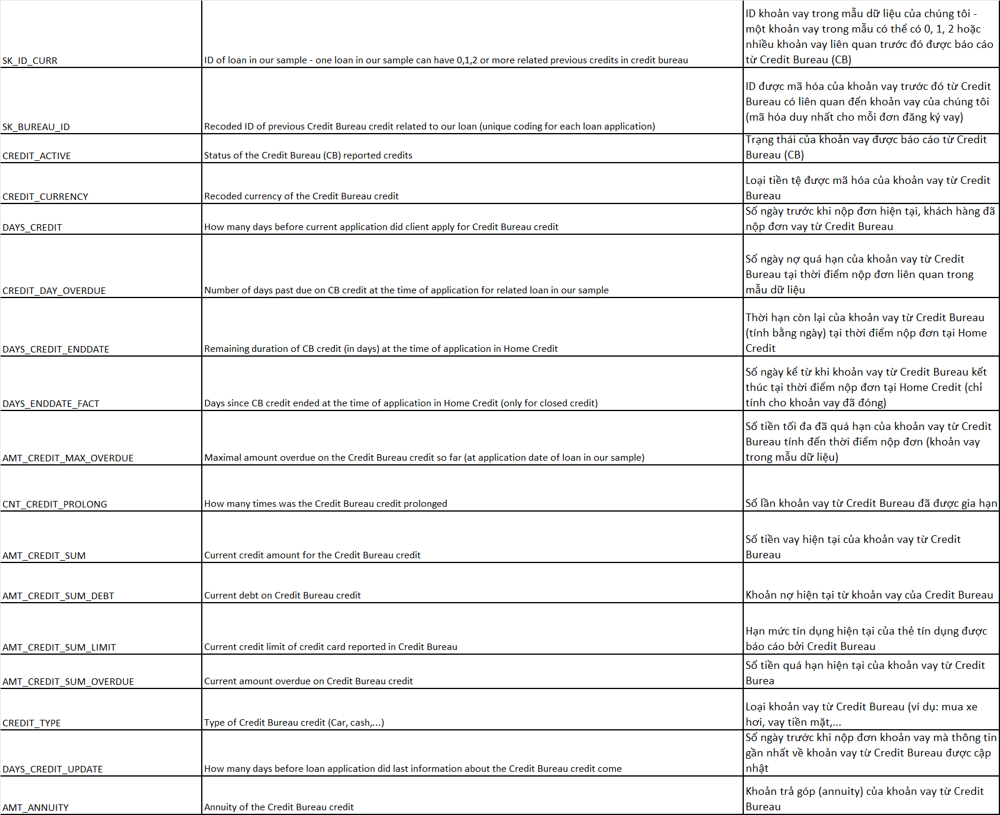

In [147]:
bureau_balance_df = pd.read_csv('/content/dseb63_bureau_balance.csv')
bureau_balance_df.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0.0,C
1,5715448,-1.0,C
2,5715448,-2.0,C
3,5715448,-3.0,C
4,5715448,-4.0,C


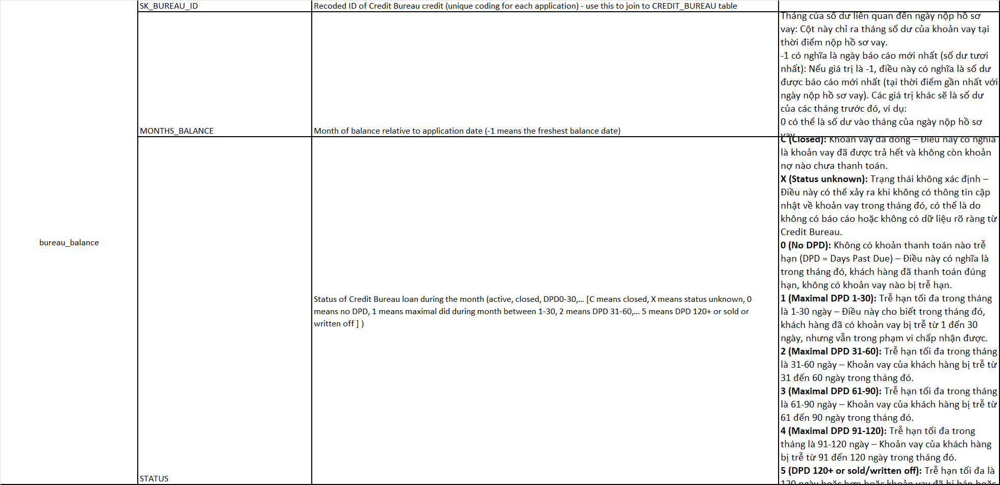

# **ABOUT DATA**
- Check info
- Check describe
- Check duplicates
- Check missing values
- Check outlier

## bureau_df

In [75]:
bureau_df.shape

(1465325, 17)

In [76]:
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465325 entries, 0 to 1465324
Data columns (total 17 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1465325 non-null  int64  
 1   CREDIT_ACTIVE           1465325 non-null  object 
 2   CREDIT_CURRENCY         1465325 non-null  object 
 3   DAYS_CREDIT             1465325 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1465325 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1376227 non-null  float64
 6   DAYS_ENDDATE_FACT       920652 non-null   float64
 7   AMT_CREDIT_MAX_OVERDUE  516780 non-null   float64
 8   CNT_CREDIT_PROLONG      1465325 non-null  int64  
 9   AMT_CREDIT_SUM          1465322 non-null  float64
 10  AMT_CREDIT_SUM_DEBT     1242231 non-null  float64
 11  AMT_CREDIT_SUM_LIMIT    975655 non-null   float64
 12  AMT_CREDIT_SUM_OVERDUE  1465325 non-null  float64
 13  CREDIT_TYPE             1465325 non-null  object 
 14  DA

In [77]:
bureau_df.describe()

,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY,SK_ID_CURR
count,1.465325e+06,1.465325e+06,1.465325e+06,1.376227e+06,920652.000000,5.167800e+05,1.465325e+06,1.465322e+06,1.242231e+06,9.756550e+05,1.465325e+06,1.465325e+06,3.353120e+05,1.465325e+06
mean,5.890328e+06,-1.143600e+03,8.887612e-01,4.931322e+02,-1022.765286,3.942852e+03,7.278249e-03,3.516889e+05,1.358890e+05,6.363687e+03,4.010547e+01,-5.997869e+02,1.576301e+04,1.538762e+05
std,5.378271e+05,8.000200e+02,3.824707e+01,4.964905e+03,718.371749,2.196856e+05,1.026408e-01,1.078009e+06,6.756650e+05,4.543915e+04,6.273639e+03,7.371010e+02,2.681074e+05,8.889888e+04
min,5.000000e+06,-2.922000e+03,0.000000e+00,-4.206000e+04,-42023.000000,0.000000e+00,0.000000e+00,0.000000e+00,-4.705600e+06,-5.864061e+05,0.000000e+00,-4.194700e+04,0.000000e+00,0.000000e+00
25%,5.416944e+06,-1.671000e+03,0.000000e+00,-1.144000e+03,-1503.000000,0.000000e+00,0.000000e+00,5.116500e+04,0.000000e+00,0.000000e+00,0.000000e+00,-9.040000e+02,0.000000e+00,7.668500e+04
50%,5.856021e+06,-9.850000e+02,0.000000e+00,-3.340000e+02,-900.000000,0.000000e+00,0.000000e+00,1.246981e+05,0.000000e+00,0.000000e+00,0.000000e+00,-4.060000e+02,6.750000e+01,1.540400e+05
75%,6.363543e+06,-4.700000e+02,0.000000e+00,4.730000e+02,-427.000000,0.000000e+00,0.000000e+00,3.082500e+05,3.965400e+04,0.000000e+00,0.000000e+00,-3.300000e+01,1.399050e+04,2.308560e+05
max,6.843457e+06,0.000000e+00,2.792000e+03,3.119900e+04,0.000000,1.159872e+08,9.000000e+00,3.960000e+08,1.701000e+08,4.705600e+06,3.756681e+06,3.720000e+02,5.958668e+07,3.075090e+05


### Check duplicates

In [78]:
bureau_df.duplicated().sum()

0

### Profilling

In [79]:
import sys
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
  Preparing metadata (setup.py) ... done


In [80]:
import pandas_profiling
from pandas_profiling import ProfileReport

In [81]:
profile_bureau_df = ProfileReport(bureau_df, title="BUREAU", html={'style' : {'full_width':True}})
profile_bureau_df.to_file(output_file="bureau_df.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [82]:
profile_bureau_df

### Missing Values

#### Check missing values

In [83]:
nan_percentage = bureau_df.isna().mean() * 100  # Tính phần trăm NaN cho từng cột
nan_percentage = nan_percentage.sort_values(ascending=False)  # Sắp xếp giảm dần
print(nan_percentage)

AMT_ANNUITY               77.116885
AMT_CREDIT_MAX_OVERDUE    64.732738
DAYS_ENDDATE_FACT         37.170798
AMT_CREDIT_SUM_LIMIT      33.417160
AMT_CREDIT_SUM_DEBT       15.224882
DAYS_CREDIT_ENDDATE        6.080426
AMT_CREDIT_SUM             0.000205
SK_ID_BUREAU               0.000000
DAYS_CREDIT_UPDATE         0.000000
CREDIT_TYPE                0.000000
AMT_CREDIT_SUM_OVERDUE     0.000000
CNT_CREDIT_PROLONG         0.000000
CREDIT_ACTIVE              0.000000
CREDIT_DAY_OVERDUE         0.000000
DAYS_CREDIT                0.000000
CREDIT_CURRENCY            0.000000
SK_ID_CURR                 0.000000
dtype: float64


Cột với >50% giá trị null

In [84]:
high_nan_columns = nan_percentage[nan_percentage > 50].index
print("Columns with >50% NaN values:", high_nan_columns.tolist())

Columns with >50% NaN values: ['AMT_ANNUITY', 'AMT_CREDIT_MAX_OVERDUE']


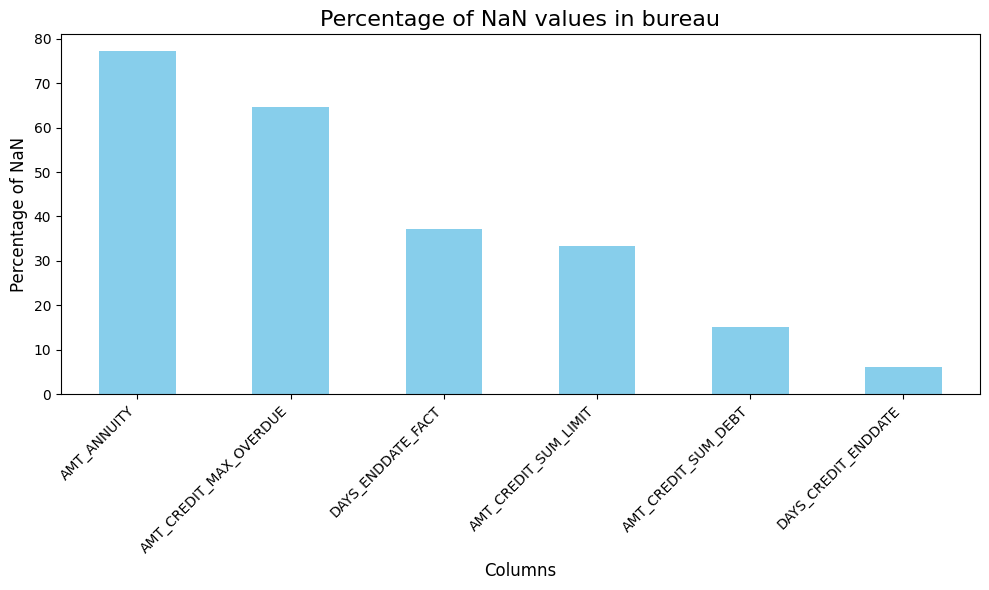

In [85]:
# Vẽ biểu đồ
selected_columns = ['DAYS_ENDDATE_FACT', 'AMT_CREDIT_SUM_LIMIT', 'AMT_CREDIT_SUM_DEBT', 'DAYS_CREDIT_ENDDATE', 'AMT_ANNUITY', 'AMT_CREDIT_MAX_OVERDUE']
plt.figure(figsize=(10, 6))

# Vẽ biểu đồ
nan_percentage[selected_columns].sort_values(ascending=False).plot(kind='bar', color='skyblue')

# Cài đặt tiêu đề và nhãn
plt.title('Percentage of NaN values in bureau', fontsize=16)
plt.ylabel('Percentage of NaN', fontsize=12)
plt.xlabel('Columns', fontsize=12)

# Xoay nhãn trục x để dễ đọc
plt.xticks(rotation=45, ha='right')

# Căn chỉnh bố cục
plt.tight_layout()

# Hiển thị biểu đồ
plt.show()

In [86]:
bureau_df = bureau_df.drop(columns=['AMT_ANNUITY', 'AMT_CREDIT_MAX_OVERDUE']) # > 60% NaN
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465325 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1465325 non-null  int64  
 1   CREDIT_ACTIVE           1465325 non-null  object 
 2   CREDIT_CURRENCY         1465325 non-null  object 
 3   DAYS_CREDIT             1465325 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1465325 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1376227 non-null  float64
 6   DAYS_ENDDATE_FACT       920652 non-null   float64
 7   CNT_CREDIT_PROLONG      1465325 non-null  int64  
 8   AMT_CREDIT_SUM          1465322 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1242231 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    975655 non-null   float64
 11  AMT_CREDIT_SUM_OVERDUE  1465325 non-null  float64
 12  CREDIT_TYPE             1465325 non-null  object 
 13  DAYS_CREDIT_UPDATE      1465325 non-null  int64  
 14  SK

#### Logical Error




##### Vấn đề 1

AMT_CREDIT_SUM = AMT_CREDIT_SUM_DEBT + AMT_CREDIT_SUM_LIMIT

Check các cột:

+) Số lượng null của cột

+) Fill 0 vào cột AMT_CREDIT_SUM_DEBT

+) Xử dụng quy tắc cộng để tính cột AMT_CREDIT_SUM_LIMIT

In [87]:
# Tính tổng của AMT_CREDIT_SUM_DEBT và AMT_CREDIT_SUM_LIMIT
mismatch = bureau_df[(bureau_df['AMT_CREDIT_SUM'] != bureau_df['AMT_CREDIT_SUM_DEBT'] + bureau_df['AMT_CREDIT_SUM_LIMIT'])]

# Tính % số dòng bị lệch
mismatch_percentage = len(mismatch) / len(bureau_df) * 100
print(f"% số dòng cộng vào không bằng nhau: {mismatch_percentage:.2f}%")

% số dòng cộng vào không bằng nhau: 93.71%


In [88]:
# Tìm các dòng không có NaN ở cả 3 cột
non_nan_condition = (
    bureau_df['AMT_CREDIT_SUM'].notna() &
    bureau_df['AMT_CREDIT_SUM_DEBT'].notna() &
    bureau_df['AMT_CREDIT_SUM_LIMIT'].notna()
)

# Lọc các dòng không NaN ở cả 3 cột
non_nan_rows = bureau_df[non_nan_condition]

# Lọc ra các dòng cộng vào sai
wrong_non_nan = non_nan_rows[non_nan_rows['AMT_CREDIT_SUM'] != non_nan_rows['AMT_CREDIT_SUM_DEBT'] + non_nan_rows['AMT_CREDIT_SUM_LIMIT']]

# Tính %
wrong_non_nan_percentage = len(wrong_non_nan) / len(non_nan_rows) * 100
print(f"% số dòng không NaN cả 3 cột nhưng cộng vào sai: {wrong_non_nan_percentage:.2f}%")


% số dòng không NaN cả 3 cột nhưng cộng vào sai: 90.55%


In [89]:
# Kiểm tra số dòng có AMT_CREDIT_SUM_DEBT < 0
negative_debt_condition = bureau_df['AMT_CREDIT_SUM_DEBT'] < 0

# Tính % số dòng có AMT_CREDIT_SUM_DEBT âm
negative_debt_percentage = negative_debt_condition.sum() / len(bureau_df) * 100
print(f"% số dòng DEBT âm: {negative_debt_percentage:.2f}%")

% số dòng DEBT âm: 0.57%


In [90]:
# Tạo điều kiện kiểm tra
nan_debt_non_nan_limit_condition = bureau_df['AMT_CREDIT_SUM_DEBT'].isna() & bureau_df['AMT_CREDIT_SUM_LIMIT'].notna()

# Tính % số dòng thỏa mãn điều kiện
nan_debt_non_nan_limit_percentage = nan_debt_non_nan_limit_condition.sum() / len(bureau_df) * 100
print(f"% số dòng NaN DEBT nhưng không NaN AMT_CREDIT_SUM_LIMIT: {nan_debt_non_nan_limit_percentage:.2f}%")

% số dòng NaN DEBT nhưng không NaN AMT_CREDIT_SUM_LIMIT: 0.01%


In [91]:
#Xoá các dòng có DEBT âm
bureau_df = bureau_df[bureau_df['AMT_CREDIT_SUM_DEBT'] >= 0]
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1233813 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1233813 non-null  int64  
 1   CREDIT_ACTIVE           1233813 non-null  object 
 2   CREDIT_CURRENCY         1233813 non-null  object 
 3   DAYS_CREDIT             1233813 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1233813 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165607 non-null  float64
 6   DAYS_ENDDATE_FACT       763750 non-null   float64
 7   CNT_CREDIT_PROLONG      1233813 non-null  int64  
 8   AMT_CREDIT_SUM          1233810 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1233813 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    967158 non-null   float64
 11  AMT_CREDIT_SUM_OVERDUE  1233813 non-null  float64
 12  CREDIT_TYPE             1233813 non-null  object 
 13  DAYS_CREDIT_UPDATE      1233813 non-null  int64  
 14  SK_ID_C

In [92]:
#Fill 0 vào những dòng DEBT null, xoá 3 dòng NaN cột AMT_CREDIT_SUM
bureau_df['AMT_CREDIT_SUM_DEBT'] = bureau_df['AMT_CREDIT_SUM_DEBT'].fillna(0)
# Xóa các dòng có giá trị NaN trong cột AMT_CREDIT_SUM
bureau_df = bureau_df[bureau_df['AMT_CREDIT_SUM'].notna()]

bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1233810 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1233810 non-null  int64  
 1   CREDIT_ACTIVE           1233810 non-null  object 
 2   CREDIT_CURRENCY         1233810 non-null  object 
 3   DAYS_CREDIT             1233810 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1233810 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165607 non-null  float64
 6   DAYS_ENDDATE_FACT       763749 non-null   float64
 7   CNT_CREDIT_PROLONG      1233810 non-null  int64  
 8   AMT_CREDIT_SUM          1233810 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1233810 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    967158 non-null   float64
 11  AMT_CREDIT_SUM_OVERDUE  1233810 non-null  float64
 12  CREDIT_TYPE             1233810 non-null  object 
 13  DAYS_CREDIT_UPDATE      1233810 non-null  int64  
 14  SK_ID_C

In [93]:
# Điều kiện 1: Cả AMT_CREDIT_SUM_DEBT và AMT_CREDIT_SUM_LIMIT đều = 0
condition1 = (bureau_df['AMT_CREDIT_SUM_DEBT'] == 0) & (bureau_df['AMT_CREDIT_SUM_LIMIT'] == 0)

# Cập nhật AMT_CREDIT_SUM cho điều kiện 1 (về 0 vì không có giá trị thực)
bureau_df.loc[condition1, 'AMT_CREDIT_SUM_LIMIT'] = bureau_df['AMT_CREDIT_SUM']

# Điều kiện 2: Tổng DEBT + LIMIT != SUM (với cả 3 đều không NaN và khác 0)
condition2 = (
    bureau_df['AMT_CREDIT_SUM_DEBT'].notna() &
    bureau_df['AMT_CREDIT_SUM_LIMIT'].notna() &
    bureau_df['AMT_CREDIT_SUM'].notna() &
    (
        (bureau_df['AMT_CREDIT_SUM_DEBT'] != 0) |
        (bureau_df['AMT_CREDIT_SUM_LIMIT'] != 0)
    )
)

# Điều chỉnh AMT_CREDIT_SUM cho điều kiện 2
bureau_df.loc[condition2, 'AMT_CREDIT_SUM'] = bureau_df['AMT_CREDIT_SUM_DEBT'] + bureau_df['AMT_CREDIT_SUM_LIMIT']

# Điều kiện 3: AMT_CREDIT_SUM_LIMIT = NaN nhưng AMT_CREDIT_SUM và AMT_CREDIT_SUM_DEBT không NaN
condition3 = (
    bureau_df['AMT_CREDIT_SUM_LIMIT'].isna() &
    bureau_df['AMT_CREDIT_SUM_DEBT'].notna() &
    bureau_df['AMT_CREDIT_SUM'].notna()
)

# Cập nhật AMT_CREDIT_SUM_LIMIT cho điều kiện 3
bureau_df.loc[condition3, 'AMT_CREDIT_SUM_LIMIT'] = bureau_df['AMT_CREDIT_SUM'] - bureau_df['AMT_CREDIT_SUM_DEBT']

# Kiểm tra lại dữ liệu sau khi điều chỉnh
bureau_df[['AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT', 'AMT_CREDIT_SUM_LIMIT']].head()

,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT
0,91323.0,0.00,91323.00
1,225000.0,171342.00,53658.00
5,180000.0,71017.38,108982.62
6,42103.8,42103.80,0.00
7,494550.0,0.00,494550.00


##### Vấn đề 2
DAYS_CREDIT_ENDDATE và DAYS_CREDIT_ENDDATE_FACT

- Check enddate < 0 mà enddate_fact > 0
- Check khoản vay đã closed và enddate_fact NaN => fill 0 (ý nghĩa là hiện tại đã trả)



In [94]:
invalid_rows = bureau_df[(bureau_df['DAYS_CREDIT_ENDDATE'] < 0) & (bureau_df['DAYS_ENDDATE_FACT'] > 0)]

# Hiển thị số dòng vi phạm và các dòng đó
print(f"Số dòng vi phạm điều kiện (DAYS_CREDIT_ENDDATE < 0 và DAYS_ENDDATE_FACT > 0): {len(invalid_rows)}")
print(invalid_rows[['DAYS_CREDIT_ENDDATE', 'DAYS_ENDDATE_FACT']].head())

Số dòng vi phạm điều kiện (DAYS_CREDIT_ENDDATE < 0 và DAYS_ENDDATE_FACT > 0): 0
Empty DataFrame
Columns: [DAYS_CREDIT_ENDDATE, DAYS_ENDDATE_FACT]
Index: []


In [95]:
closed_with_nan_enddate_fact = bureau_df[(bureau_df['CREDIT_ACTIVE'] == 'Closed') & bureau_df['DAYS_ENDDATE_FACT'].isna()]
closed_with_nan_enddate_fact

,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,SK_ID_CURR
9196,5726601,Closed,currency 1,-877,0,967.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-540,110802
11221,6022336,Closed,currency 1,-1129,0,727.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-515,109863
36904,5808793,Closed,currency 1,-745,0,1087.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-407,289846
38566,5810529,Closed,currency 1,-942,0,903.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-421,164969
59831,5238629,Closed,currency 1,-791,0,1046.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-423,189679
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1350614,6722508,Closed,currency 1,-775,0,1080.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-526,20215
1369653,5978588,Closed,currency 1,-824,0,1015.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-517,214287
1371950,5350133,Closed,currency 1,-680,0,1161.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-402,51203
1373029,5353743,Closed,currency 1,-593,0,1248.0,NaN,0,0.0,0.0,0.0,0.0,Credit card,-527,269459


In [96]:
# Fill 0 vào days_enddate_fact (ý nghĩa: đã hoàn thành vào hôm nay)
bureau_df.loc[(bureau_df['CREDIT_ACTIVE'] == 'Closed') & bureau_df['DAYS_ENDDATE_FACT'].isna(), 'DAYS_ENDDATE_FACT'] = 0

# Kiểm tra lại các dòng đã thay đổi
bureau_df[bureau_df['DAYS_ENDDATE_FACT'] == 0]

,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,SK_ID_CURR
9196,5726601,Closed,currency 1,-877,0,967.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-540,110802
11221,6022336,Closed,currency 1,-1129,0,727.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-515,109863
23120,5200052,Closed,currency 1,-78,0,-16.0,0.0,0,67500.0,0.0,67500.0,0.0,Consumer credit,0,297572
36904,5808793,Closed,currency 1,-745,0,1087.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-407,289846
38566,5810529,Closed,currency 1,-942,0,903.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-421,164969
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1371950,5350133,Closed,currency 1,-680,0,1161.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-402,51203
1373029,5353743,Closed,currency 1,-593,0,1248.0,0.0,0,0.0,0.0,0.0,0.0,Credit card,-527,269459
1418951,5758434,Closed,currency 1,-75,0,NaN,0.0,0,36000.0,0.0,36000.0,0.0,Microloan,0,306940
1418953,5758436,Closed,currency 1,-32,0,NaN,0.0,0,22500.0,0.0,22500.0,0.0,Microloan,0,306940


In [97]:
bureau_df[(bureau_df['AMT_CREDIT_SUM'] == 0) & (bureau_df['AMT_CREDIT_SUM_DEBT'] == 0) & (bureau_df['AMT_CREDIT_SUM_LIMIT'] == 0) & (bureau_df['DAYS_CREDIT_ENDDATE'].isna()) & (bureau_df['DAYS_ENDDATE_FACT'].isna())]

,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,SK_ID_CURR
253,5714737,Active,currency 1,-1321,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-228,18449
1039,5715587,Active,currency 1,-416,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-21,174232
1043,5715592,Active,currency 1,-1038,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-29,199939
1337,5715883,Active,currency 1,-809,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-18,145836
1437,5715986,Active,currency 1,-419,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-155,175457
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463988,6840450,Active,currency 1,-774,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-15,241574
1464421,6842007,Active,currency 1,-1229,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-1216,170953
1464657,6842658,Active,currency 1,-360,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-26,168336
1464678,6842684,Active,currency 1,-1122,0,NaN,NaN,0,0.0,0.0,0.0,0.0,Credit card,-378,209114


Xoá các dòng mà cả 3 amt đều = 0 và nan cả 2 enddate

In [98]:
condition4 = (
    (bureau_df['AMT_CREDIT_SUM'] == 0) &
    (bureau_df['AMT_CREDIT_SUM_DEBT'] == 0) &
    (bureau_df['AMT_CREDIT_SUM_LIMIT'] == 0) &
    (bureau_df['DAYS_CREDIT_ENDDATE'].isna()) &
    (bureau_df['DAYS_ENDDATE_FACT'].isna())
)

# Lọc bỏ các dòng thỏa mãn điều kiện
bureau_df = bureau_df[~condition4]
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1230606 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1230606 non-null  int64  
 1   CREDIT_ACTIVE           1230606 non-null  object 
 2   CREDIT_CURRENCY         1230606 non-null  object 
 3   DAYS_CREDIT             1230606 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1230606 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165607 non-null  float64
 6   DAYS_ENDDATE_FACT       763842 non-null   float64
 7   CNT_CREDIT_PROLONG      1230606 non-null  int64  
 8   AMT_CREDIT_SUM          1230606 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1230606 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    1230606 non-null  float64
 11  AMT_CREDIT_SUM_OVERDUE  1230606 non-null  float64
 12  CREDIT_TYPE             1230606 non-null  object 
 13  DAYS_CREDIT_UPDATE      1230606 non-null  int64  
 14  SK_ID_C

In [99]:
bureau_df = bureau_df[bureau_df['DAYS_CREDIT_UPDATE'] <= 0]
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1230589 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1230589 non-null  int64  
 1   CREDIT_ACTIVE           1230589 non-null  object 
 2   CREDIT_CURRENCY         1230589 non-null  object 
 3   DAYS_CREDIT             1230589 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1230589 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165590 non-null  float64
 6   DAYS_ENDDATE_FACT       763842 non-null   float64
 7   CNT_CREDIT_PROLONG      1230589 non-null  int64  
 8   AMT_CREDIT_SUM          1230589 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1230589 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    1230589 non-null  float64
 11  AMT_CREDIT_SUM_OVERDUE  1230589 non-null  float64
 12  CREDIT_TYPE             1230589 non-null  object 
 13  DAYS_CREDIT_UPDATE      1230589 non-null  int64  
 14  SK_ID_C

In [100]:
# Xóa các dòng mà cả DAYS_CREDIT_ENDDATE và DAYS_ENDDATE_FACT đều NaN
bureau_df = bureau_df[~(bureau_df['DAYS_CREDIT_ENDDATE'].isna() & bureau_df['DAYS_ENDDATE_FACT'].isna())]
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1184310 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1184310 non-null  int64  
 1   CREDIT_ACTIVE           1184310 non-null  object 
 2   CREDIT_CURRENCY         1184310 non-null  object 
 3   DAYS_CREDIT             1184310 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1184310 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165590 non-null  float64
 6   DAYS_ENDDATE_FACT       763842 non-null   float64
 7   CNT_CREDIT_PROLONG      1184310 non-null  int64  
 8   AMT_CREDIT_SUM          1184310 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1184310 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    1184310 non-null  float64
 11  AMT_CREDIT_SUM_OVERDUE  1184310 non-null  float64
 12  CREDIT_TYPE             1184310 non-null  object 
 13  DAYS_CREDIT_UPDATE      1184310 non-null  int64  
 14  SK_ID_C

In [101]:
(bureau_df['DAYS_CREDIT_ENDDATE'].isna().sum()/len(bureau_df)) * 100

1.5806672239531878

Vì chỉ còn lại 1.5% null nên drop và không có cách fill dữ liệu hợp lí nên drop

In [102]:
bureau_df = bureau_df[~bureau_df['DAYS_CREDIT_ENDDATE'].isna()]
bureau_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1165590 entries, 0 to 1465324
Data columns (total 15 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1165590 non-null  int64  
 1   CREDIT_ACTIVE           1165590 non-null  object 
 2   CREDIT_CURRENCY         1165590 non-null  object 
 3   DAYS_CREDIT             1165590 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1165590 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165590 non-null  float64
 6   DAYS_ENDDATE_FACT       745122 non-null   float64
 7   CNT_CREDIT_PROLONG      1165590 non-null  int64  
 8   AMT_CREDIT_SUM          1165590 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1165590 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    1165590 non-null  float64
 11  AMT_CREDIT_SUM_OVERDUE  1165590 non-null  float64
 12  CREDIT_TYPE             1165590 non-null  object 
 13  DAYS_CREDIT_UPDATE      1165590 non-null  int64  
 14  SK_ID_C

In [103]:
(bureau_df['DAYS_ENDDATE_FACT'].isna().sum() / len(bureau_df)) * 100

36.073404885079654

Đối với các tài khoản vẫn còn quá hạn enddate hoặc còn hạn enddate trong tương lai, không thể fill nan vào cột enddate_fact một cách hợp lí

Phần null của DAYS_ENDDATE_FACT không thể xử lí là khoảng 38%

In [104]:
bureau_df = bureau_df.drop(columns=['DAYS_ENDDATE_FACT'])
bureau_df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 1165590 entries, 0 to 1465324
Data columns (total 14 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_BUREAU            1165590 non-null  int64  
 1   CREDIT_ACTIVE           1165590 non-null  object 
 2   CREDIT_CURRENCY         1165590 non-null  object 
 3   DAYS_CREDIT             1165590 non-null  int64  
 4   CREDIT_DAY_OVERDUE      1165590 non-null  int64  
 5   DAYS_CREDIT_ENDDATE     1165590 non-null  float64
 6   CNT_CREDIT_PROLONG      1165590 non-null  int64  
 7   AMT_CREDIT_SUM          1165590 non-null  float64
 8   AMT_CREDIT_SUM_DEBT     1165590 non-null  float64
 9   AMT_CREDIT_SUM_LIMIT    1165590 non-null  float64
 10  AMT_CREDIT_SUM_OVERDUE  1165590 non-null  float64
 11  CREDIT_TYPE             1165590 non-null  object 
 12  DAYS_CREDIT_UPDATE      1165590 non-null  int64  
 13  SK_ID_CURR              1165590 non-null  int64  
dtypes: floa

### Move SK_ID_CURR to 0th position

In [105]:
# MOVE LAST COLUMN TO Oth POSITION
column_to_move = 'SK_ID_CURR'

# Get a list of column names excluding the column to move
other_columns = [col for col in bureau_df.columns if col != column_to_move]

# Reorder the columns with the column to move at the beginning
bureau_df = bureau_df[[column_to_move] + other_columns]

# Display the updated DataFrame
bureau_df.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE
0,254629,5714462,Closed,currency 1,-497,0,-153.0,0,91323.0,0.00,91323.00,0.0,Consumer credit,-131
1,254629,5714463,Active,currency 1,-208,0,1075.0,0,225000.0,171342.00,53658.00,0.0,Credit card,-20
5,254629,5714467,Active,currency 1,-273,0,27460.0,0,180000.0,71017.38,108982.62,0.0,Credit card,-31
6,254629,5714468,Active,currency 1,-43,0,79.0,0,42103.8,42103.80,0.00,0.0,Consumer credit,-22
7,254629,5714458,Closed,currency 1,-1872,0,-776.0,0,494550.0,0.00,494550.00,0.0,Consumer credit,-696


In [106]:
print(f'Number of unique SK_ID_BUREAU in bureau.csv are: {len(bureau_df.SK_ID_BUREAU.unique())}')
print(f'Number of unique SK_ID_CURR in bureau.csv are: {len(bureau_df.SK_ID_CURR.unique())}')

Number of unique SK_ID_BUREAU in bureau.csv are: 1165590
Number of unique SK_ID_CURR in bureau.csv are: 253708


### OUTLIER

#### Check outlier

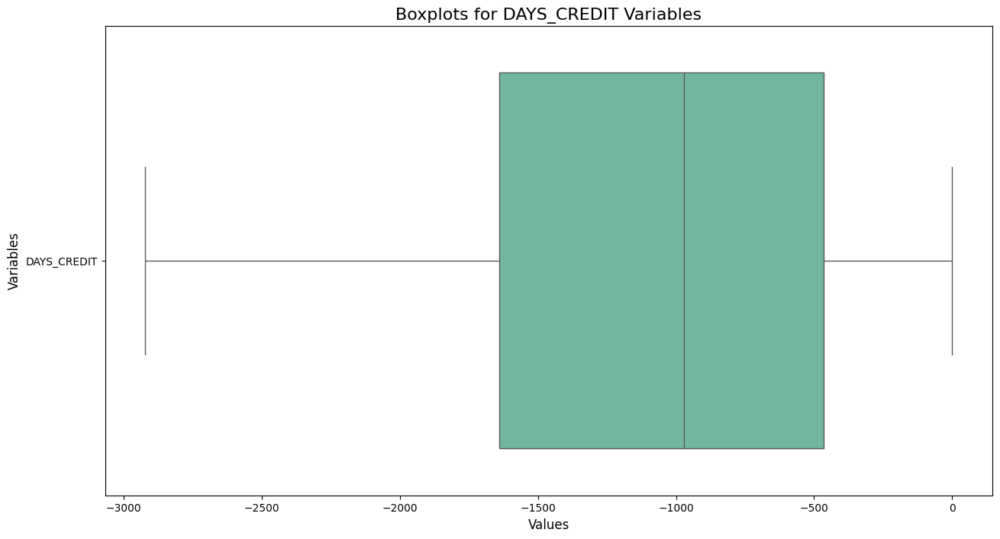

In [108]:
selected_columns = ['DAYS_CREDIT']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

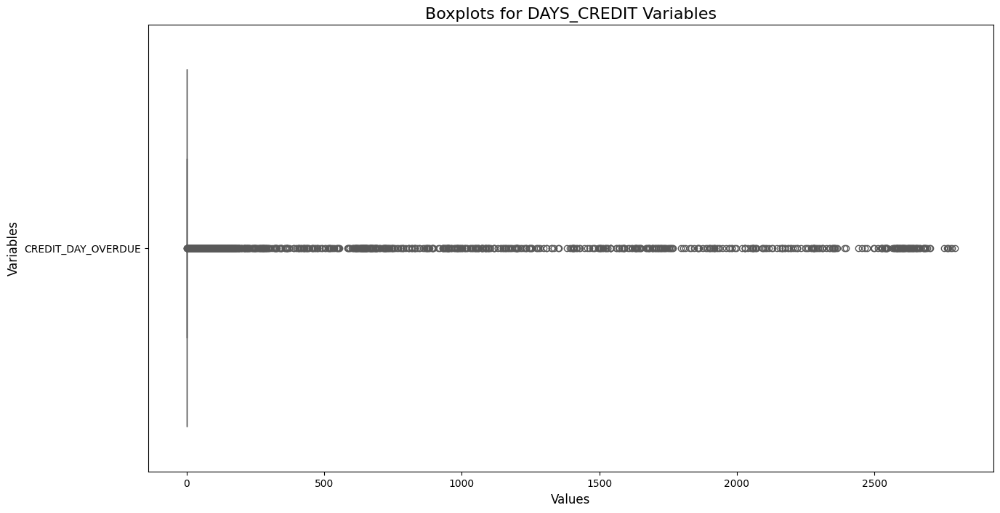

In [109]:
selected_columns = ['CREDIT_DAY_OVERDUE']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

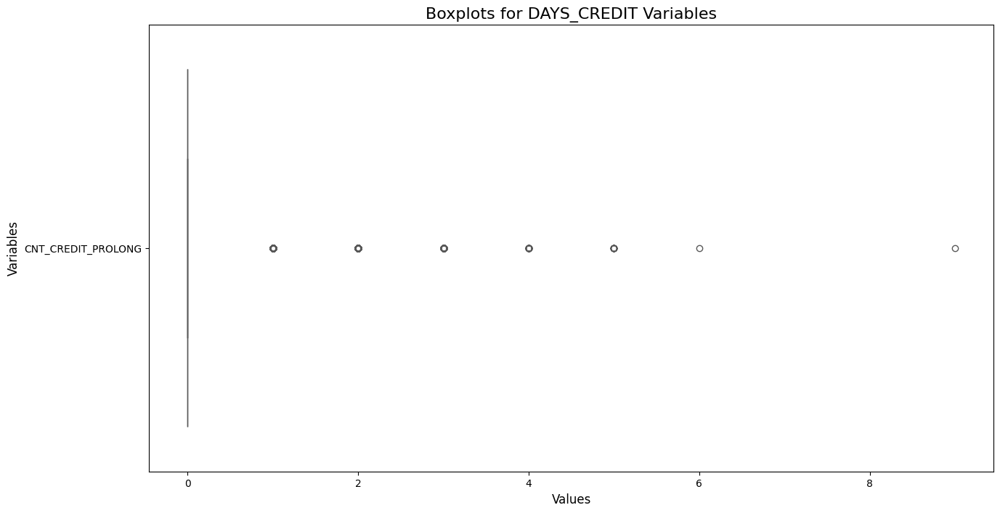

In [110]:
selected_columns = ['CNT_CREDIT_PROLONG']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

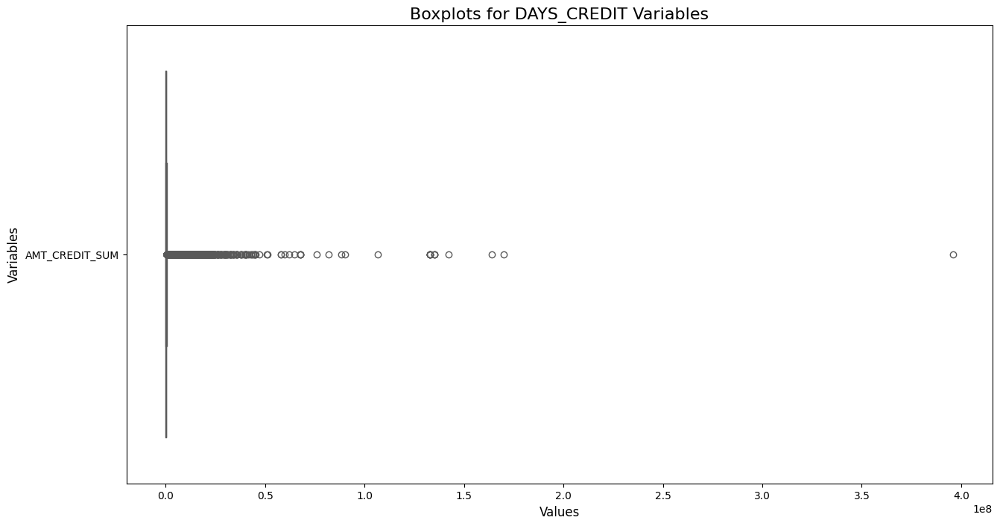

In [111]:
selected_columns = ['AMT_CREDIT_SUM']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

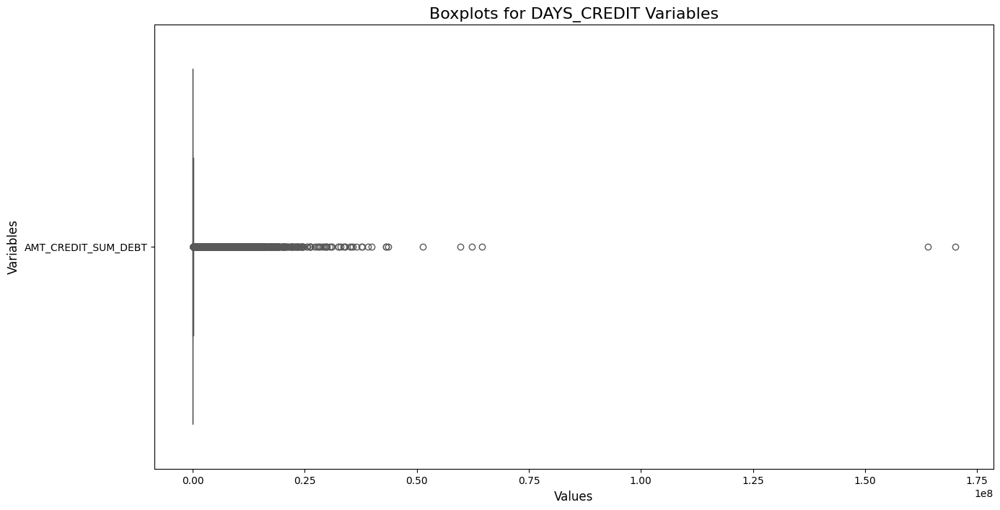

In [112]:
selected_columns = ['AMT_CREDIT_SUM_DEBT']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

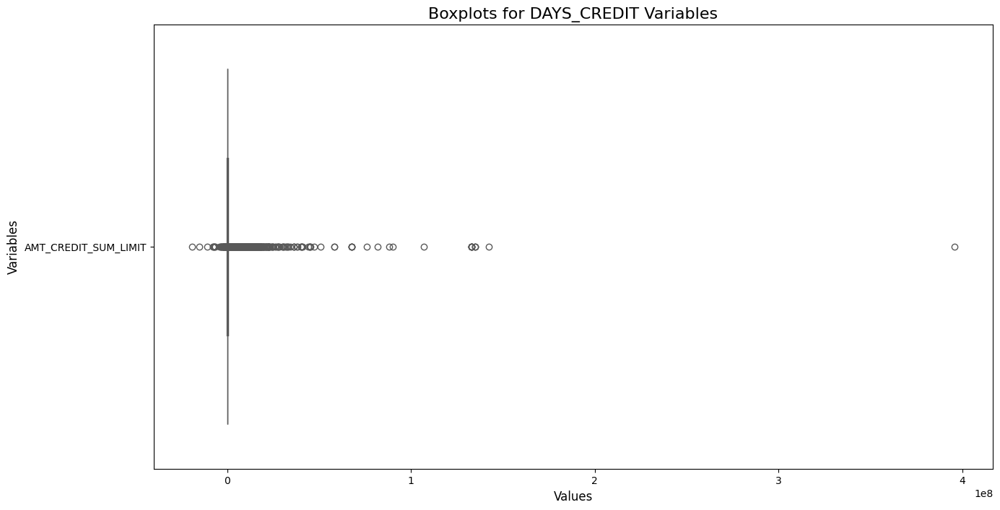

In [113]:
selected_columns = ['AMT_CREDIT_SUM_LIMIT']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

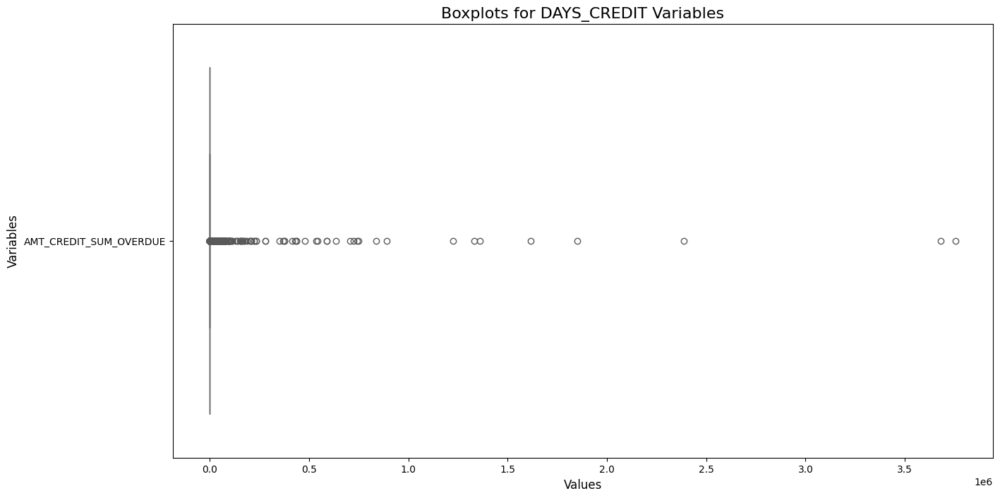

In [114]:
selected_columns = ['AMT_CREDIT_SUM_OVERDUE']

# Tạo boxplot
plt.figure(figsize=(15, 8))
sns.boxplot(data=bureau_df[selected_columns], orient="h", palette="Set2")
plt.title("Boxplots for DAYS_CREDIT Variables", fontsize=16)
plt.xlabel("Values", fontsize=12)
plt.ylabel("Variables", fontsize=12)
plt.show()

In [115]:
numerical_columns = bureau_df.select_dtypes(include=['int64', 'float64'])

# Tính toán IQR (Interquartile Range)
Q1 = numerical_columns.quantile(0.25)  # Phân vị thứ 25
Q3 = numerical_columns.quantile(0.75)  # Phân vị thứ 75
IQR = Q3 - Q1                          # Phạm vi liên phân vị

# Xác định outliers: giá trị nằm ngoài khoảng [Q1 - 1.5*IQR, Q3 + 1.5*IQR]
outliers = ((numerical_columns < (Q1 - 1.5 * IQR)) | (numerical_columns > (Q3 + 1.5 * IQR)))

# Lọc các dòng chứa outliers
rows_with_outliers = bureau_df[outliers.any(axis=1)]

# Hiển thị kết quả
print("Rows with outliers:")
print(rows_with_outliers)

Rows with outliers:
         SK_ID_CURR  SK_ID_BUREAU CREDIT_ACTIVE CREDIT_CURRENCY  DAYS_CREDIT  \
1            254629       5714463        Active      currency 1         -208   
5            254629       5714467        Active      currency 1         -273   
7            254629       5714458        Closed      currency 1        -1872   
8            254629       5714459        Closed      currency 1        -1734   
15           270608       5714473        Closed      currency 1        -2456   
...             ...           ...           ...             ...          ...   
1465314       82504       5094072        Active      currency 1        -1119   
1465316       82535       5044500        Active      currency 1         -420   
1465320       66820       5052629        Closed      currency 1         -532   
1465322      118290       5043236        Active      currency 1        -1441   
1465324      139955       5053356        Closed      currency 1        -2724   

         CREDIT_DAY

#### Xử lí outlier

In [116]:
numeric_cols = bureau_df.select_dtypes(include=['float64', 'int64']).columns

for col in numeric_cols:
    if bureau_df[col].notna().sum() > 0:  # Chỉ xử lý nếu cột có dữ liệu
        mean = bureau_df[col].mean()
        std = bureau_df[col].std()

        # Xác định ngưỡng dưới và ngưỡng trên
        lower_bound = mean - 3 * std
        upper_bound = mean + 3 * std

        # Gắn cờ giá trị outlier
        outliers = (bureau_df[col] < lower_bound) | (bureau_df[col] > upper_bound)

        # Xử lý outlier: Thay thế bằng median
        median = bureau_df[col].median()
        bureau_df.loc[outliers, col] = median

# Xác nhận thay đổi
print("Xử lý outlier hoàn tất.")

<ipython-input-116-2f084dd97f98>:17: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5856724.5' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  bureau_df.loc[outliers, col] = median


Xử lý outlier hoàn tất.


##bureau_balance

In [148]:
bureau_balance_df = pd.read_csv('/content/dseb63_bureau_balance.csv')

In [149]:
bureau_balance_df.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0.0,C
1,5715448,-1.0,C
2,5715448,-2.0,C
3,5715448,-3.0,C
4,5715448,-4.0,C


In [150]:
bureau_balance_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4118437 entries, 0 to 4118436
Data columns (total 3 columns):
 #   Column          Dtype  
---  ------          -----  
 0   SK_ID_BUREAU    int64  
 1   MONTHS_BALANCE  float64
 2   STATUS          object 
dtypes: float64(1), int64(1), object(1)
memory usage: 94.3+ MB


In [151]:
bureau_balance_df.describe()

,SK_ID_BUREAU,MONTHS_BALANCE
count,4.118437e+06,4.118436e+06
mean,5.951618e+06,-2.984928e+01
std,4.860419e+05,2.348927e+01
min,5.001710e+06,-9.600000e+01
25%,5.720410e+06,-4.400000e+01
50%,5.903049e+06,-2.400000e+01
75%,6.364203e+06,-1.100000e+01
max,6.834719e+06,0.000000e+00


In [152]:
bureau_balance_df.duplicated().sum()

0

In [153]:
bureau_balance_df.isna().sum()

,0
SK_ID_BUREAU,0
MONTHS_BALANCE,1
STATUS,1


# EXPORT FILE CLEAN

In [117]:
bureau_df.to_csv('bureau_clean.csv', index=False)

In [118]:
bureau = pd.read_csv('/content/bureau_clean.csv')
bureau.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1165590 entries, 0 to 1165589
Data columns (total 14 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   SK_ID_CURR              1165590 non-null  int64  
 1   SK_ID_BUREAU            1165590 non-null  float64
 2   CREDIT_ACTIVE           1165590 non-null  object 
 3   CREDIT_CURRENCY         1165590 non-null  object 
 4   DAYS_CREDIT             1165590 non-null  int64  
 5   CREDIT_DAY_OVERDUE      1165590 non-null  int64  
 6   DAYS_CREDIT_ENDDATE     1165590 non-null  float64
 7   CNT_CREDIT_PROLONG      1165590 non-null  int64  
 8   AMT_CREDIT_SUM          1165590 non-null  float64
 9   AMT_CREDIT_SUM_DEBT     1165590 non-null  float64
 10  AMT_CREDIT_SUM_LIMIT    1165590 non-null  float64
 11  AMT_CREDIT_SUM_OVERDUE  1165590 non-null  float64
 12  CREDIT_TYPE             1165590 non-null  object 
 13  DAYS_CREDIT_UPDATE      1165590 non-null  int64  
dtypes:

In [119]:
bureau.isna().sum()

,0
SK_ID_CURR,0
SK_ID_BUREAU,0
CREDIT_ACTIVE,0
CREDIT_CURRENCY,0
DAYS_CREDIT,0
CREDIT_DAY_OVERDUE,0
DAYS_CREDIT_ENDDATE,0
CNT_CREDIT_PROLONG,0
AMT_CREDIT_SUM,0
AMT_CREDIT_SUM_DEBT,0


# **EDA**

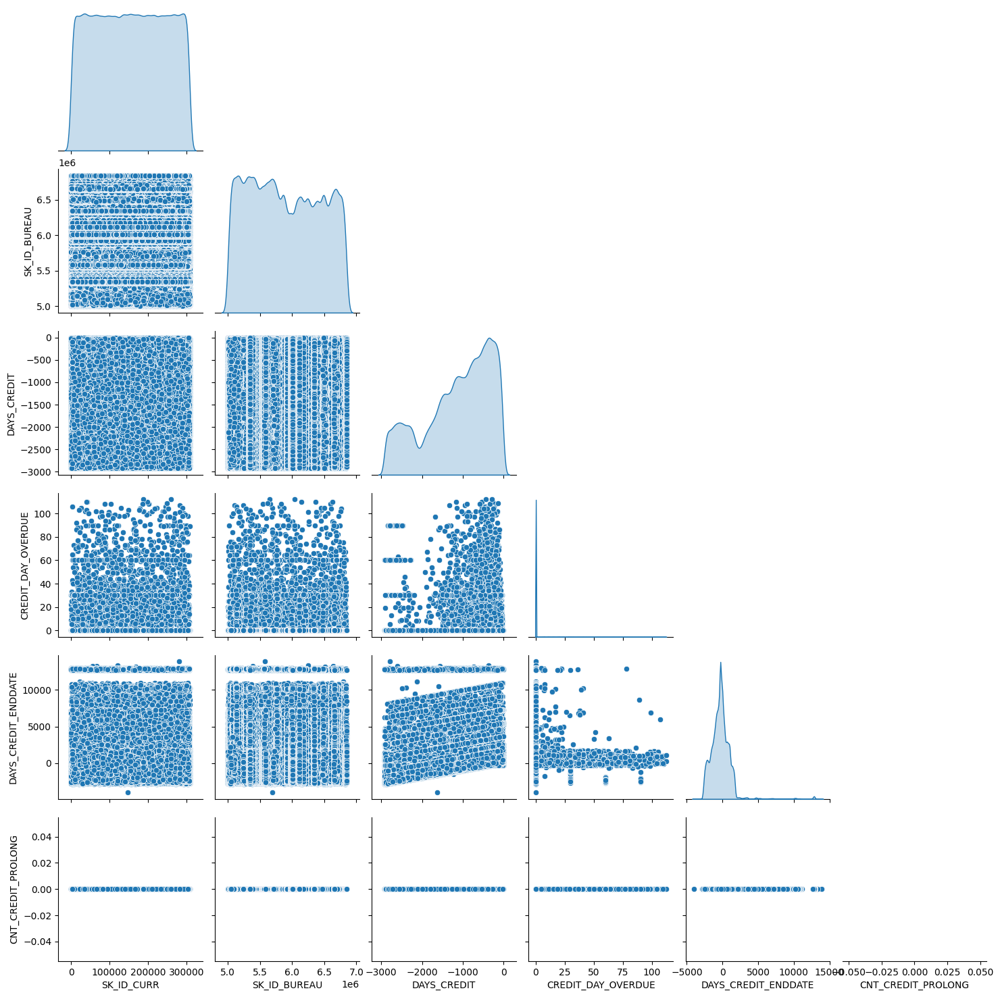

In [120]:
numeric_cols = bureau_df.select_dtypes(include=['float64', 'int64']).columns

# Chọn 6 cột đầu tiên để hiển thị (có thể thay đổi danh sách này)
selected_numeric_cols = numeric_cols[:6]

# Tạo một DataFrame mới chỉ với các cột đã chọn
subset_df = bureau_df[selected_numeric_cols]

# Loại bỏ các hàng chứa giá trị NaN (nếu cần)
subset_df = subset_df.dropna()

# Vẽ biểu đồ pairplot
sns.pairplot(subset_df, diag_kind="kde", corner=True)  # `diag_kind="kde"` hiển thị mật độ trên đường chéo
plt.show()

**Đường chéo (Diagonal - Phân phối KDE của từng biến)**
SK_ID_CURR và SK_ID_BUREAU:

Các giá trị phân bố khá đều, cho thấy đây là dữ liệu định danh (ID) thay vì giá trị số học có ý nghĩa thực sự.
Không có cụm rõ ràng hoặc bất thường trong phân phối.
DAYS_CREDIT:

Phân phối lệch trái, đa số các giá trị nằm ở vùng âm.
Điều này cho thấy phần lớn các khoản vay đã tồn tại từ lâu (các ngày âm biểu thị thời điểm trước ngày hiện tại).
CREDIT_DAY_OVERDUE:

Hầu hết các giá trị là 0 hoặc rất thấp, thể hiện rằng phần lớn các khoản vay không có ngày quá hạn hoặc chỉ quá hạn ít ngày.
DAYS_CREDIT_ENDDATE:

Phân phối lệch phải với một số giá trị cực đại, cho thấy một số khoản vay còn thời gian rất dài trước khi hết hạn.
Có thể có lỗi hoặc ngoại lệ cần kiểm tra nếu các giá trị cực kỳ lớn không hợp lý.
DAYS_ENDDATE_FACT:

Phân phối cho thấy đa phần các khoản vay đã đóng có thời gian kết thúc gần hiện tại (giá trị dương nhỏ).
Một số trường hợp giá trị âm, cần kiểm tra thêm để hiểu ý nghĩa.
Các ô ngoài đường chéo (Mối quan hệ giữa các cặp biến)
DAYS_CREDIT vs. DAYS_CREDIT_ENDDATE:

Có một mối tương quan nghịch tuyến tính nhẹ. Khi khoản vay đã mở từ lâu (DAYS_CREDIT âm), thời gian còn lại để hoàn thành khoản vay (DAYS_CREDIT_ENDDATE) thường thấp.
DAYS_CREDIT vs. CREDIT_DAY_OVERDUE:

Không có mối quan hệ rõ ràng. Có thể giải thích rằng số ngày quá hạn không phụ thuộc trực tiếp vào thời gian mở khoản vay.
DAYS_CREDIT vs. DAYS_ENDDATE_FACT:

Đối với các khoản vay đã đóng, dường như có mối quan hệ cho thấy thời gian khoản vay tồn tại (DAYS_CREDIT) có thể ảnh hưởng đến thời điểm khoản vay kết thúc (DAYS_ENDDATE_FACT).
DAYS_CREDIT_ENDDATE vs. DAYS_ENDDATE_FACT:

Hai biến này có mối quan hệ ngược chiều với một số điểm bất thường, như trường hợp DAYS_CREDIT_ENDDATE dương nhưng DAYS_ENDDATE_FACT âm hoặc NaN.

**Nhận xét bổ sung**

Cụm bất thường: Một số cụm giá trị trên trục DAYS_CREDIT_ENDDATE và DAYS_ENDDATE_FACT có vẻ không khớp, cần kiểm tra lại logic của các giá trị này.
Dữ liệu quá hạn (CREDIT_DAY_OVERDUE): Các giá trị quá hạn (nếu có) không phân bố đồng đều với các biến khác. Phần lớn khoản vay không bị quá hạn, nhưng có một số điểm bất thường với giá trị cao cần điều tra.

## Categorical

### Univariate

In [121]:
numeric_cols = bureau_df.select_dtypes(include=['object']).columns
numeric_cols

Index(['CREDIT_ACTIVE', 'CREDIT_CURRENCY', 'CREDIT_TYPE'], dtype='object')

In [122]:
(bureau_df['CREDIT_ACTIVE'].value_counts()/len(bureau_df))*100

,count
CREDIT_ACTIVE,
Closed,63.699843
Active,36.114929
Sold,0.184113
Bad debt,0.001115


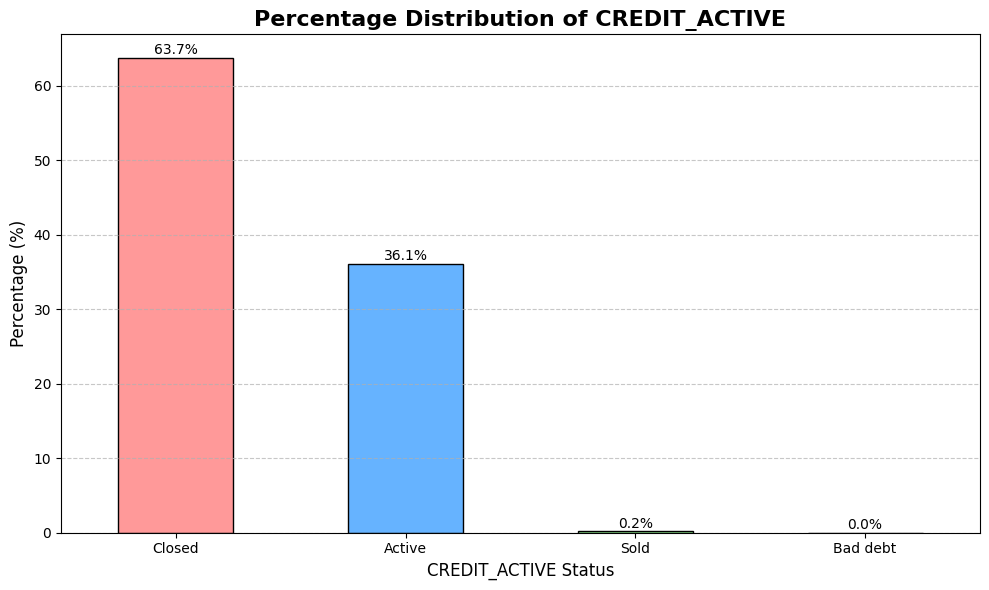

In [123]:
# Tính tỷ lệ phần trăm các giá trị trong cột 'CREDIT_ACTIVE'
credit_active_percentage = (bureau_df['CREDIT_ACTIVE'].value_counts() / len(bureau_df)) * 100

# Vẽ biểu đồ bar chart
plt.figure(figsize=(10, 6))
credit_active_percentage.plot(
    kind='bar',
    color=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99'],  # Tùy chỉnh màu sắc
    edgecolor='black'
)

# Cài đặt tiêu đề và nhãn
plt.title('Percentage Distribution of CREDIT_ACTIVE', fontsize=16, fontweight='bold')
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel('CREDIT_ACTIVE Status', fontsize=12)

# Hiển thị giá trị trên mỗi cột
for i, v in enumerate(credit_active_percentage):
    plt.text(i, v + 0.5, f'{v:.1f}%', ha='center', fontsize=10)

plt.xticks(rotation=0)  # Giữ nhãn trục x nằm ngang
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Thêm lưới nhẹ ở trục y
plt.tight_layout()  # Đảm bảo biểu đồ không bị cắt
plt.show()

1. **The majority of accounts are closed (Closed - 63.7%)**:  
   - Nearly two-thirds of the accounts have been closed, indicating a trend of credit obligations being fulfilled or customers deciding to stop using the current credit services.

2. **A significant portion of accounts are still active (Active - 36.1%)**:  
   - About one-third of the accounts remain active, representing the current customer base and an opportunity to maintain or grow revenue through additional financial products or services.

3. **Very low proportion of "Sold" and "Bad debt" accounts (0.2% and 0.0%)**:  
   - Accounts that were sold or categorized as bad debt are minimal. This could suggest effective credit risk management or that the dataset focuses on high-quality accounts.

---

**Recommendations for action**:

- **Analyze active accounts further**:  
   Understand why customers continue to use the service and find ways to optimize their experience.

- **Investigate reasons for account closure**:  
   If closures are due to customer dissatisfaction, improvements in services could enhance customer retention.

- **Leverage low bad debt ratios**:  
   The extremely low bad debt ratio may provide opportunities to access new funding or expand the credit portfolio with minimal risk.

In [124]:
bad_debt_accounts = bureau_df[bureau_df['CREDIT_ACTIVE'] == 'Bad debt']
bad_debt_accounts

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE
29866,106615,5801236.0,Bad debt,currency 1,-2627,0,-1529.0,0,90000.00,115349.715,-25349.715,0.0,Credit card,-1502
113214,301057,5600466.0,Bad debt,currency 1,-1046,0,52.0,0,135000.00,176233.500,-41233.500,0.0,Credit card,-63
358515,90732,5173404.0,Bad debt,currency 1,-2740,0,-2558.0,0,7717.50,7717.500,0.000,7717.5,Consumer credit,-888
464110,128551,5997537.0,Bad debt,currency 1,-1502,0,-1292.0,0,57960.00,0.000,57960.000,0.0,Consumer credit,-1292
545313,68550,5499851.0,Bad debt,currency 1,-1218,0,-852.0,0,121275.00,0.000,121275.000,0.0,Consumer credit,-1035
608323,158804,6439586.0,Bad debt,currency 1,-2830,0,-2434.0,0,58567.68,0.000,58567.680,0.0,Consumer credit,-1781
613922,244804,6441729.0,Bad debt,currency 1,-2899,0,-1773.0,0,365670.72,0.000,365670.720,0.0,Consumer credit,-1434
796723,290806,5309530.0,Bad debt,currency 1,-2112,0,-1900.0,0,22510.89,0.000,22510.890,0.0,Consumer credit,-1550
825449,242509,5445963.0,Bad debt,currency 1,-2547,0,-2150.0,0,41310.00,0.000,41310.000,0.0,Consumer credit,-765
1206097,291484,5300044.0,Bad debt,currency 1,-2834,0,-1724.0,0,135000.00,182632.635,-47632.635,0.0,Credit card,-642


In [125]:
credit_currency_percentage = (bureau_df['CREDIT_CURRENCY'].value_counts()/len(bureau_df))*100
credit_currency_percentage

,count
CREDIT_CURRENCY,
currency 1,99.923215
currency 2,0.065460
currency 3,0.010553
currency 4,0.000772


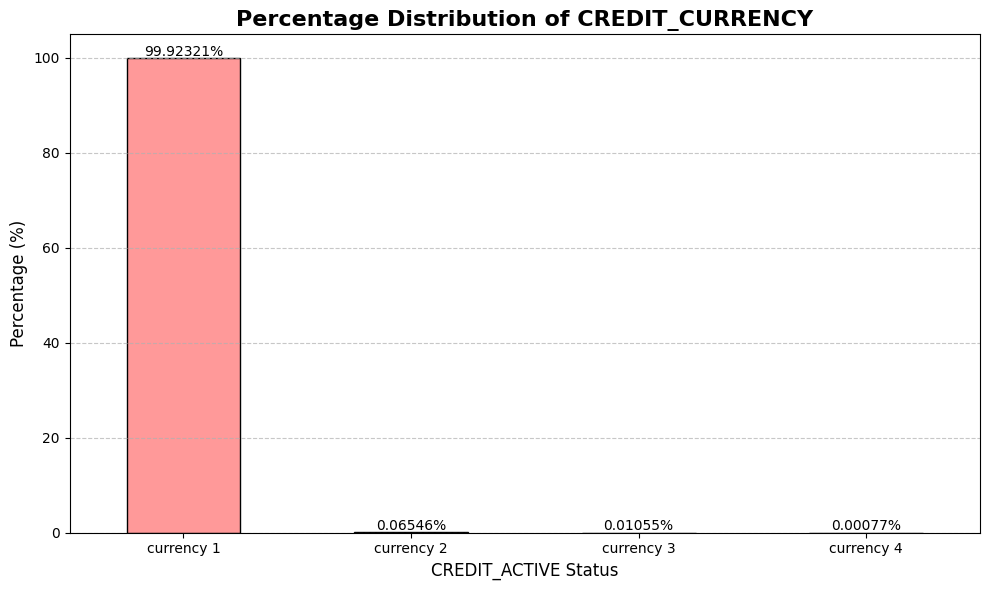

In [126]:
# Tính tỷ lệ phần trăm các giá trị trong cột 'CREDIT_CURRENCY'
numeric_cols = bureau_df.select_dtypes(include=['object']).columns

# Vẽ biểu đồ bar chart
plt.figure(figsize=(10, 6))
credit_currency_percentage.plot(
    kind='bar',
    color=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99'],  # Tùy chỉnh màu sắc
    edgecolor='black'
)

# Cài đặt tiêu đề và nhãn
plt.title('Percentage Distribution of CREDIT_CURRENCY', fontsize=16, fontweight='bold')
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel('CREDIT_ACTIVE Status', fontsize=12)

# Hiển thị giá trị trên mỗi cột
for i, v in enumerate(credit_currency_percentage):
    plt.text(i, v + 0.5, f'{v:.5f}%', ha='center', fontsize=10)

plt.xticks(rotation=0)  # Giữ nhãn trục x nằm ngang
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Thêm lưới nhẹ ở trục y
plt.tight_layout()  # Đảm bảo biểu đồ không bị cắt
plt.show()

1. **Dominance of currency 1 (99.92%)**:  
   - The overwhelming majority of the credit accounts are in "currency 1," accounting for almost 100% of the data. This indicates that the majority of transactions or credit activities are conducted in this currency.

2. **Minimal usage of other currencies (currency 2, 3, and 4)**:  
   - Very small percentages (0.065%, 0.01055%, and 0.00077% respectively) are attributed to other currencies. These figures suggest that these currencies are used very rarely, if at all, and likely represent specialized or niche use cases.

---

**Recommendations**:

- **Focus on currency 1**:  
   Since the vast majority of credit activity revolves around "currency 1," it's crucial to analyze and optimize processes, services, and risks associated with this currency.

- **Evaluate the need for other currencies**:  
   With such low usage of other currencies, it may be worth examining whether these currencies serve specific customer segments or if they could be discontinued or consolidated to streamline operations.

In [127]:
credit_type_percentage = (bureau_df['CREDIT_TYPE'].value_counts()/len(bureau_df))*100
credit_type_percentage

,count
CREDIT_TYPE,
Consumer credit,76.406541
Credit card,20.379979
Car loan,1.580487
Mortgage,1.063667
Microloan,0.352954
Loan for business development,0.120711
Unknown type of loan,0.040495
Another type of loan,0.028569
Loan for working capital replenishment,0.022821


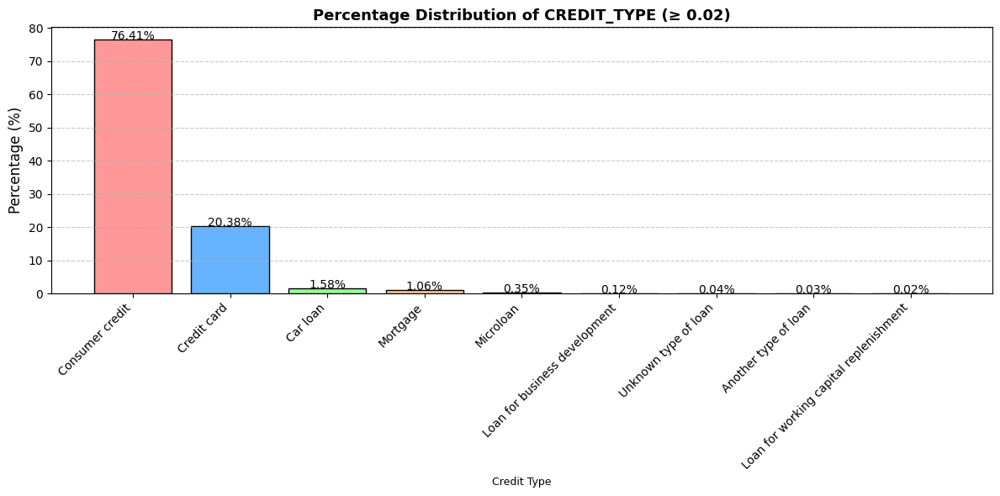

In [128]:
filtered_data = credit_type_percentage[credit_type_percentage >= 0.02]

# Vẽ biểu đồ bar chart
plt.figure(figsize=(12, 6))
bars = plt.bar(
    filtered_data.index,
    filtered_data.values,
    color=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99', 'gray'],  # Màu sắc cho cột
    edgecolor='black'  # Đường viền
)

# Thêm tiêu đề và nhãn trục
plt.title('Percentage Distribution of CREDIT_TYPE (≥ 0.02)', fontsize=13, fontweight='bold')
plt.ylabel('Percentage (%)', fontsize=12)
plt.xlabel('Credit Type', fontsize=9)

# Thêm giá trị vào đỉnh của mỗi cột
for i, v in enumerate(filtered_data.values):
    plt.text(i, v + 0.001, f'{v:.2f}%', ha='center', fontsize=10)  # Chỉnh sửa định dạng thành dạng phần trăm

# Tùy chỉnh trục x để nhãn dễ đọc hơn
plt.xticks(rotation=45, ha='right')
plt.tight_layout()  # Đảm bảo biểu đồ không bị cắt
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Lưới nhẹ trên trục y
plt.show()

1. **Dominance of consumer credit (76.41%)**:  
   - The vast majority of credit types fall under "consumer credit," indicating a primary focus on personal financing needs such as general-purpose loans or short-term credit.

2. **Significant share for credit cards (20.38%)**:  
   - Credit cards make up the second-largest category, reflecting a widespread usage of revolving credit for everyday purchases.

3. **Low utilization of other credit types**:  
   - Categories like car loans (1.58%), mortgages (1.06%), microloans (0.35%), and others contribute marginally to the overall distribution. Specialized loans (e.g., loans for business development, working capital replenishment) have negligible percentages, suggesting they are niche products or serve a small customer base.

---

**Recommendations**:

- **Focus on consumer credit and credit cards**:  
   These two categories dominate the market. Efforts should be made to optimize and expand these offerings, such as better interest rates or tailored repayment plans.

- **Explore growth opportunities in lesser-used credit types**:  
   With low usage of mortgages, car loans, and business loans, there may be untapped potential to develop these segments through marketing or product diversification.

- **Assess niche loan products**:  
   Evaluate the viability of continuing niche products like microloans or working capital loans. These may either require better promotion or could be discontinued if unprofitable.

###Bivariate

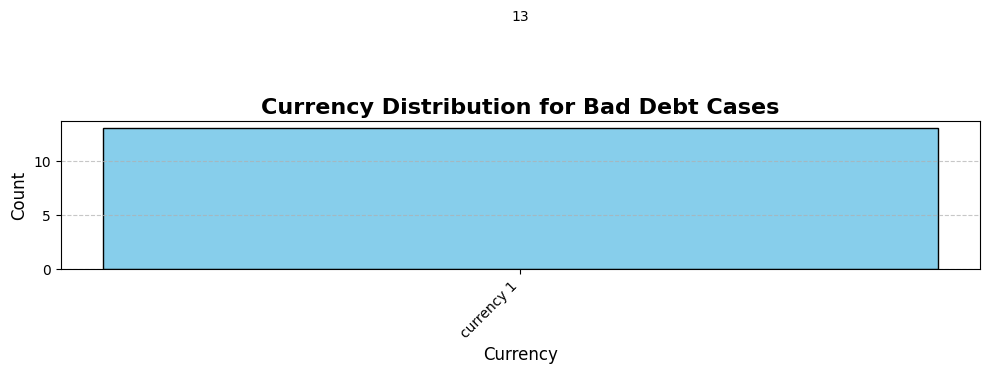

In [129]:
# Lọc dữ liệu với điều kiện CREDIT_ACTIVE = 'Bad debt'
bad_debt_df = bureau_df[bureau_df['CREDIT_ACTIVE'] == 'Bad debt']

# Kiểm tra phân phối các loại tiền tệ được sử dụng
currency_distribution = bad_debt_df['CREDIT_CURRENCY'].value_counts()

# Vẽ biểu đồ bar chart
plt.figure(figsize=(10, 6))
bars = plt.bar(
    currency_distribution.index,
    currency_distribution.values,
    color='skyblue',
    edgecolor='black'
)

# Cài đặt tiêu đề và nhãn
plt.title('Currency Distribution for Bad Debt Cases', fontsize=16, fontweight='bold')
plt.xlabel('Currency', fontsize=12)
plt.ylabel('Count', fontsize=12)

# Hiển thị giá trị trên mỗi cột
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height + 10,
        f'{int(height)}',
        ha='center',
        fontsize=10
    )

# Tùy chỉnh trục x
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

# Hiển thị biểu đồ
plt.show()


With 'Bad Debt', most are used Currency 1

In [130]:
application_train = pd.read_csv('/content/dseb63_application_train.csv', index_col = 0)
application_train.head()

,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_CURR
0,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,278621
1,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,297000.0,...,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,139008
2,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,513000.0,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,138348
3,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,454500.0,...,0,0,0,0.0,0.0,0.0,0.0,1.0,1.0,64140
4,0,Cash loans,M,Y,Y,0,360000.0,1530000.0,42075.0,1530000.0,...,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,219374


In [131]:
#merge bureau vs application_train
bureau_merged = application_train[['TARGET','SK_ID_CURR']].merge(bureau_df, on = 'SK_ID_CURR', how = 'left')
bureau_merged.head()

,TARGET,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE
0,0,278621,5885877.0,Closed,currency 1,-2586.0,0.0,-2434.0,0.0,22248.0,0.0,22248.0,0.0,Consumer credit,-2131.0
1,0,278621,5885878.0,Closed,currency 1,-1636.0,0.0,-540.0,0.0,112500.0,0.0,112500.0,0.0,Credit card,-540.0
2,0,278621,5885879.0,Closed,currency 1,-775.0,0.0,-420.0,0.0,72652.5,0.0,72652.5,0.0,Consumer credit,-550.0
3,0,278621,5885880.0,Active,currency 1,-606.0,0.0,1216.0,0.0,810000.0,0.0,810000.0,0.0,Credit card,-43.0
4,0,139008,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [132]:
pip install phik


### Correlation PhiK Matrix

interval columns not set, guessing: ['TARGET']


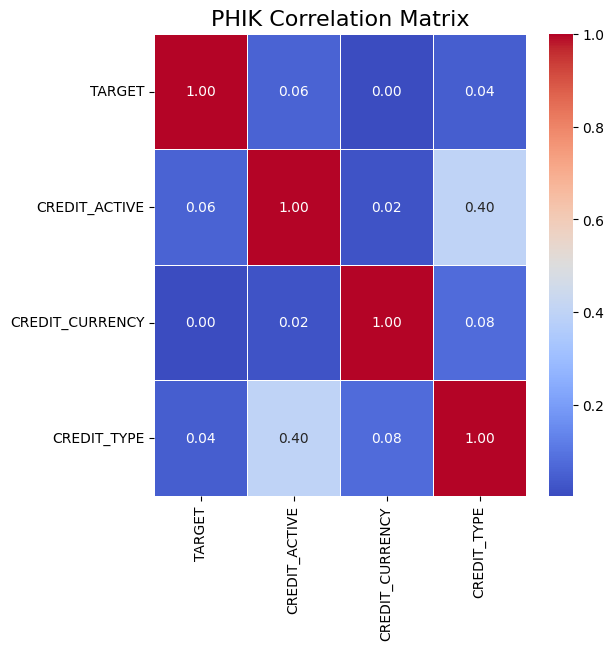

In [133]:
# Import thư viện cần thiết
from phik import phik_matrix
import matplotlib.pyplot as plt

# Chọn các cột cần tính toán ma trận PHIK
cols_for_phik = ['TARGET', 'CREDIT_ACTIVE', 'CREDIT_CURRENCY', 'CREDIT_TYPE']

# Tính toán ma trận PHIK
phik_corr = bureau_merged[cols_for_phik].phik_matrix()

# Vẽ ma trận PHIK
plt.figure(figsize=(6, 6))
plt.title("PHIK Correlation Matrix", fontsize=16)
import seaborn as sns
sns.heatmap(phik_corr, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5, cbar=True)
plt.show()

* No strong correlations between TARGET and other variables: The Phik values between TARGET and CREDIT_ACTIVE, CREDIT_CURRENCY, and CREDIT_TYPE are all relatively small (0.06, 0.00, and 0.04 respectively). This suggests there's no strong linear relationship between the target variable and these credit attributes. However, it's important to note that Phik only measures linear correlation, and more complex, non-linear relationships may exist that Phik doesn't capture.

* Moderate correlation between CREDIT_ACTIVE and CREDIT_TYPE: The Phik value of 0.40 indicates a moderate association between these two variables. This implies that the type of credit might be related to whether the credit is active or not.

* Weak correlations for remaining variables: CREDIT_CURRENCY shows weak correlations with TARGET, CREDIT_ACTIVE, and CREDIT_TYPE (0.00, 0.02, and 0.08 respectively).

In [134]:
# Hàm vẽ biểu đồ thanh chỉ cho TARGET = 1
def plot_b_stats(feature, label_rotation=False, horizontal_layout=True):
    # Count the total number of contracts for each category
    temp = bureau_merged[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index, 'Number of contracts': temp.values})

    # Calculate the percentage of target=1 (Default) per category value
    cat_perc = bureau_merged[[feature, 'TARGET']].groupby([feature]).TARGET.mean() * 100
    cat_perc = cat_perc.reset_index().rename(columns={'TARGET': 'Default (%)'})
    cat_perc.sort_values(by='Default (%)', ascending=False, inplace=True)

    # Set up the plots
    if horizontal_layout:
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(14, 6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12, 14))

    # Plot the total number of contracts
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x=feature, y="Number of contracts", data=df1)
    ax1.set_title('Total Number of Contracts', fontsize=12)
    if label_rotation:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)

    # Plot only the percentage of Default (TARGET=1)
    s = sns.barplot(ax=ax2, x=feature, y='Default (%)', data=cat_perc, color='red')
    ax2.set_title('Percentage of Default (TARGET = 1)', fontsize=12)
    ax2.set_ylabel('Percentage [%]', fontsize=10)
    if label_rotation:
        s.set_xticklabels(s.get_xticklabels(), rotation=90)

    plt.tight_layout()
    plt.show()

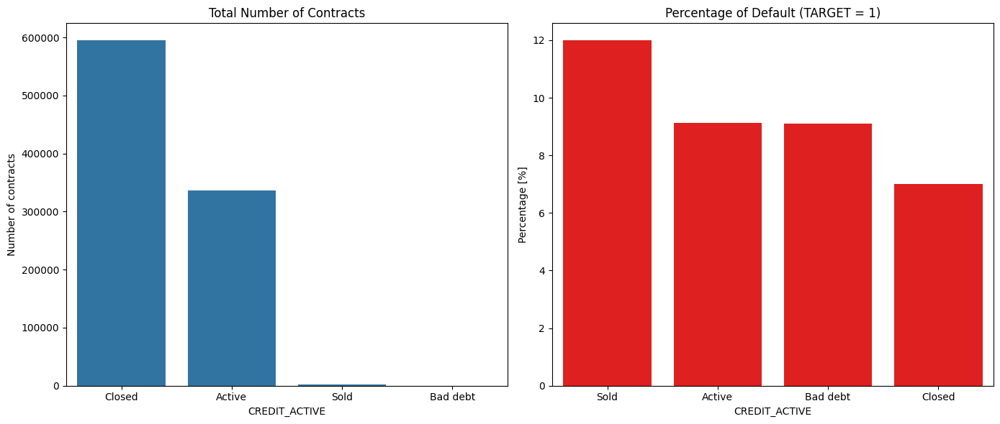

In [135]:
plot_b_stats('CREDIT_ACTIVE')


**Default Percentage (TARGET = 1) (Right Chart)**:
1. **CREDIT_ACTIVE = Sold**:
   - Has the highest default rate (~12%).
   - This suggests that contracts transferred to third parties (Sold) often involve customers with a high risk of default.

2. **CREDIT_ACTIVE = Active**:
   - A relatively high default rate (~8%), reflecting potential risks in active contracts.
   - This group is critical to manage as it represents customers with ongoing financial obligations.

3. **CREDIT_ACTIVE = Closed**:
   - A low default rate (~6%), indicating that most completed contracts (Closed) are not associated with default.
   - It can be assumed that many customers fulfilled their financial obligations responsibly.

4. **CREDIT_ACTIVE = Bad debt**:
   - Default rate is not clearly shown (likely due to a small sample size), but this is a high-risk group that requires further investigation.

---

**Key Insights**:
- The **"Sold" group** is the highest-risk category, with a default rate significantly higher than the other groups. This could be because loans are often transferred to third parties when they are deemed risky.
- The **"Active group"** needs careful management as, although it doesn’t have the highest default rate, the large number of contracts means the overall risk is still substantial.
- The **"Closed group"** has the lowest default rate, indicating that customers tend to fulfill their financial obligations before the contract ends.


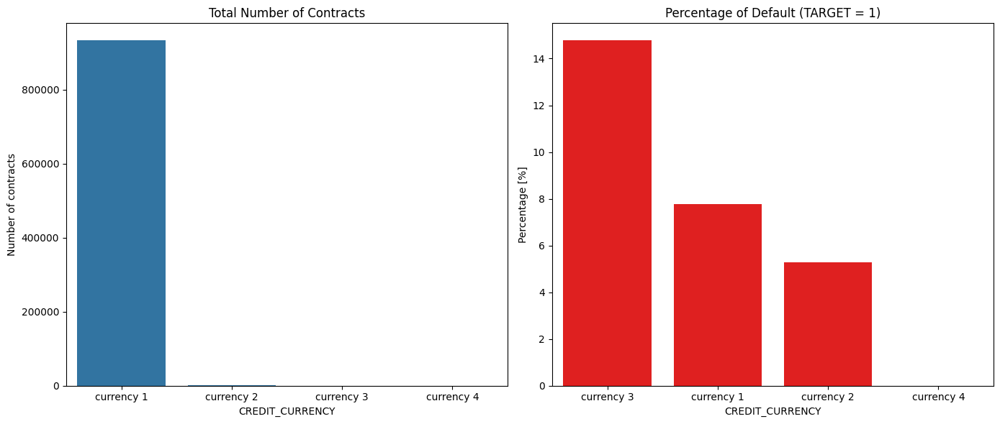

In [136]:
plot_b_stats('CREDIT_CURRENCY')

- CURRENCY_1 is both the most used currency and has the highest default rate. Its dominance in the dataset makes it a critical focus for risk management.
- CURRENCY_2 contracts exhibit a lower default percentage but represent a much smaller portion of the data.
- CURRENCY_3 has negligible representation, making it less relevant for overall insights, though it may still warrant investigation depending on its financial significance.

<ipython-input-134-672bba22f025>:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  s.set_xticklabels(s.get_xticklabels(), rotation=90)
<ipython-input-134-672bba22f025>:30: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  s.set_xticklabels(s.get_xticklabels(), rotation=90)


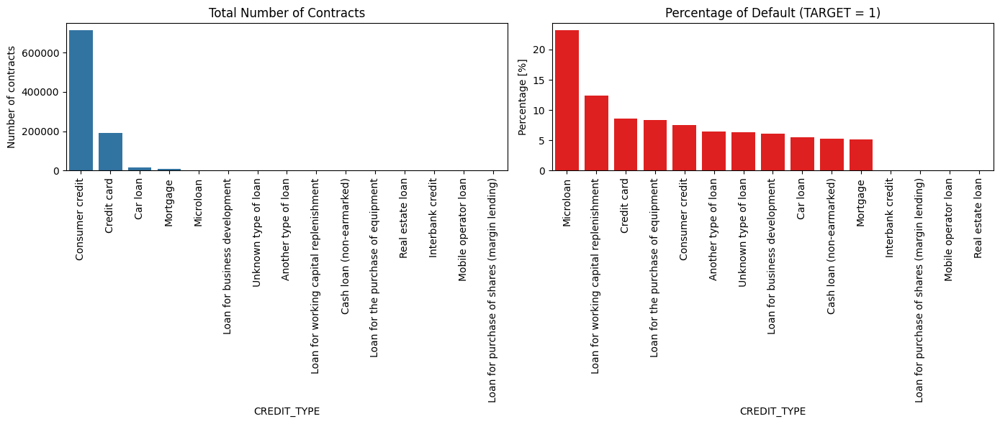

In [137]:
plot_b_stats('CREDIT_TYPE', True, True)

**Total Number of Contracts (Left Chart):**
1. **Consumer Credit:**
   - The most prevalent loan type, with approximately **80,000 contracts**.
   - This type of credit is highly popular, indicating a strong demand for consumer loans.

2. **Credit Card:**
   - The second most common type, but significantly fewer contracts compared to **Consumer Credit**.
   - Although it is a popular financial product, it serves a different purpose compared to consumer credit.

3. **Other Loan Types:**
   - Types such as **Car Loan**, **Mortgage**, and **Microloan** have much lower numbers of contracts.
   - These are often specialized loans, serving smaller target groups.

---

**Percentage of Default (TARGET = 1) (Right Chart):**
1. **Microloan:**
   - Has the highest default rate, approximately **17.5%**.
   - This could be due to the smaller loan amounts or higher interest rates, which are typically associated with higher risks.

2. **Another Type of Loan:**
   - Shows the second-highest default rate, indicating that this less common loan type carries a high risk of default.

3. **Consumer Credit and Credit Card:**
   - Despite having high numbers of contracts, **Consumer Credit (~10%)** and **Credit Card (~8%)** have moderate default rates.
   - However, due to their large volume, these types contribute significantly to the total number of defaults.

4. **Low-Risk Loan Types:**
   - **Mortgage** and **Car Loan** have relatively lower default rates, making them less risky compared to other loan types.
---
- Microloans stand out as the riskiest credit type, demanding stricter risk management strategies.
- Consumer Credit, due to its sheer volume, is the most impactful category for managing overall defaults, even though its default rate is moderate.
- Secured loans like Car Loans and Mortgages show lower risk, likely benefiting from collateral requirements.
- Focused interventions could target high-default categories, such as Microloans and Another Type of Loan, for improved portfolio performance.

## Numerical

### Univariate

<ipython-input-138-d773904c62fd>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(bureau_df[feature].dropna(),color=color, kde=True,bins=100)


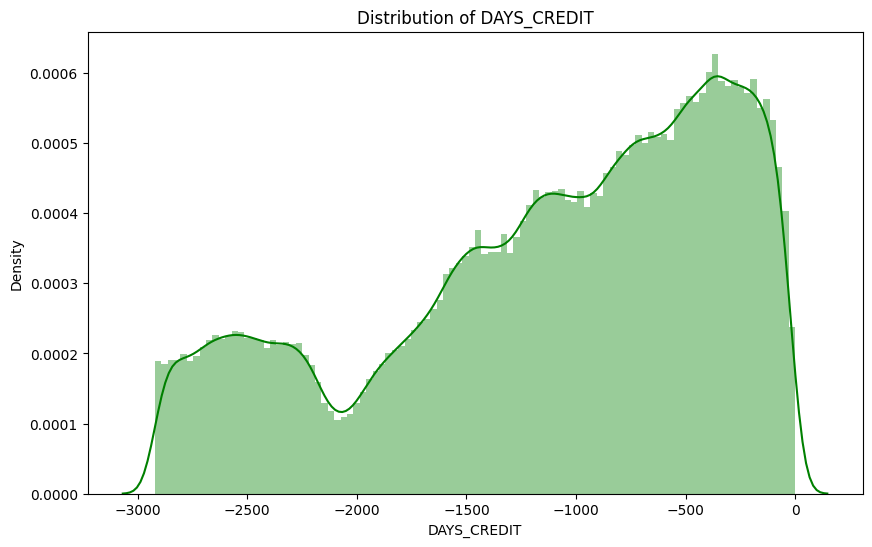

In [138]:
def plot_b_distribution(feature,color):
    plt.figure(figsize=(10,6))
    plt.title("Distribution of %s" % feature)
    sns.distplot(bureau_df[feature].dropna(),color=color, kde=True,bins=100)
    plt.show()


plot_b_distribution('DAYS_CREDIT','green')

### Multivariate

In [139]:
def plot_b_distribution_comp(var, nrow=2):
    i = 0
    t1 = bureau_merged.loc[bureau_merged['TARGET'] == 1]
    t0 = bureau_merged.loc[bureau_merged['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow, 2, figsize=(12, 6 * nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow, 2, i)

        # Plot the KDE for TARGET = 1 and TARGET = 0
        sns.kdeplot(t1[feature], bw=0.5, label="TARGET = 1", color='red')
        sns.kdeplot(t0[feature], bw=0.5, label="TARGET = 0", color='blue')

        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        plt.legend(title="TARGET", fontsize=12)  # Add the legend to indicate the target classes
        plt.tick_params(axis='both', which='major', labelsize=12)

    plt.tight_layout()
    plt.show()

<ipython-input-139-01df3b3a8b26>:15: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.

  sns.kdeplot(t1[feature], bw=0.5, label="TARGET = 1", color='red')
<ipython-input-139-01df3b3a8b26>:16: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.

  sns.kdeplot(t0[feature], bw=0.5, label="TARGET = 0", color='blue')
<ipython-input-139-01df3b3a8b26>:15: UserWarning: 

The `bw` parameter is deprecated in favor of `bw_method` and `bw_adjust`.
Setting `bw_method=0.5`, but please see the docs for the new parameters
and update your code. This will become an error in seaborn v0.14.0.

  sns.kdeplot(t1[feature], bw=0.5, label="TARGET = 1", color='

<Figure size 640x480 with 0 Axes>

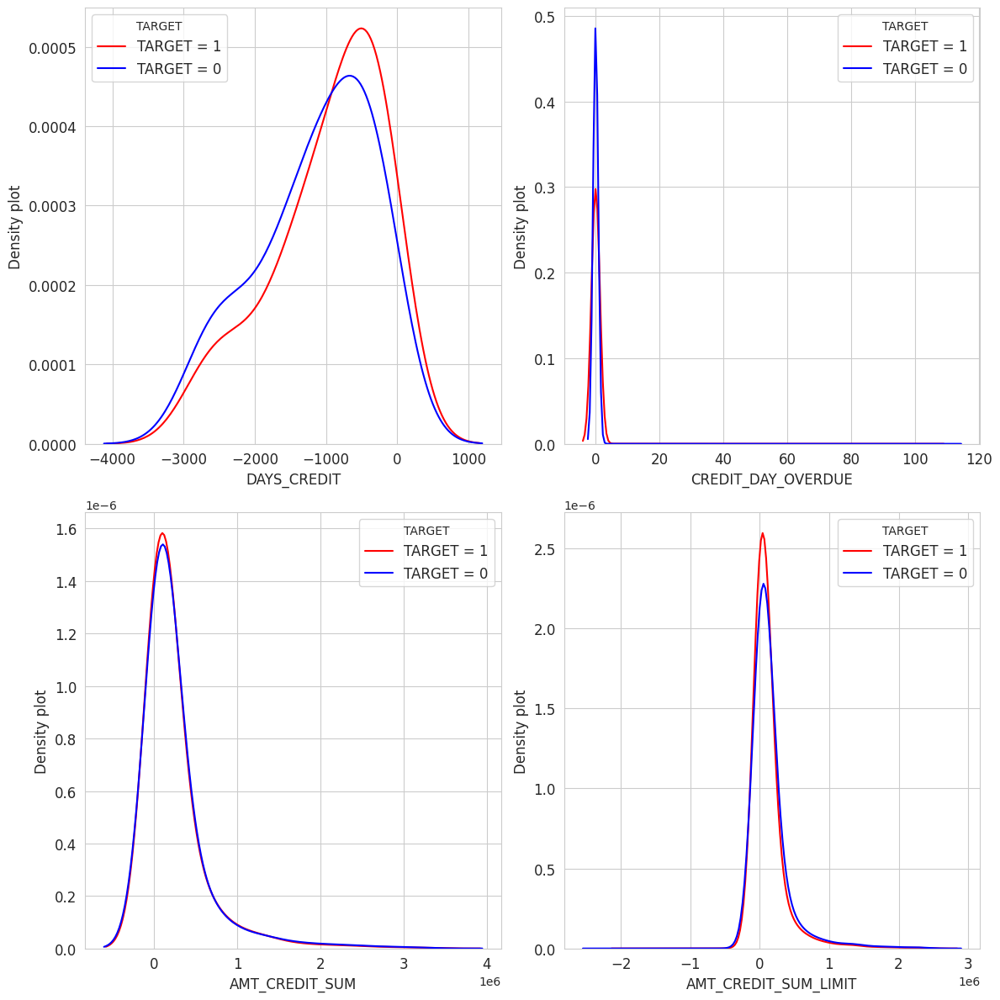

In [140]:
var = ['DAYS_CREDIT','CREDIT_DAY_OVERDUE','AMT_CREDIT_SUM','AMT_CREDIT_SUM_LIMIT']

plot_b_distribution_comp(var, nrow=2)

1. **DAYS_CREDIT:** The number of days the credit was granted. Negative values indicate the credit was granted further in the past. The distribution shows that higher-risk clients (TARGET=1) tend to have received credit more recently than lower-risk clients (TARGET=0).

2. **CREDIT_DAY_OVERDUE:** The number of days the credit is overdue.  The peak at 0 for both groups indicates that most clients do not have overdue credit. However, there is a small portion of TARGET=1 clients with overdue credit.

3. **AMT_CREDIT_SUM:** The total amount of current credit. Both groups have similar distributions, with the majority of loans being at the lower end. However, there seems to be a slightly higher proportion of TARGET=1 clients with larger loan amounts compared to TARGET=0 clients.

4. **AMT_CREDIT_SUM_LIMIT:** The current credit limit. Similar to AMT_CREDIT_SUM, both groups have similar distributions, but there seems to be a slightly higher proportion of TARGET=1 clients with higher credit limits compared to TARGET=0 clients.

**In summary:** The charts suggest that higher-risk clients (TARGET=1) tend to have received credit more recently, are more likely to have overdue credit, and may have slightly higher total credit amounts and credit limits compared to lower-risk clients (TARGET=0). However, the differences between the two groups are not stark in all variables, suggesting the need to consider additional factors for credit risk assessment.


In [141]:
num_of_type_target = bureau_merged[['SK_ID_CURR','CREDIT_TYPE','TARGET']].groupby(['SK_ID_CURR','TARGET']).nunique().reset_index()
num_of_type_target.columns = ['SK_ID_CURR','TARGET','num_of_credit_type']
num_of_type_target

,SK_ID_CURR,TARGET,num_of_credit_type
0,0,0,1
1,1,1,1
2,2,0,1
3,3,0,2
4,4,0,2
...,...,...,...
246004,307505,0,1
246005,307506,0,1
246006,307507,0,0
246007,307509,0,2


In [142]:
num_of_type = bureau_df[['SK_ID_CURR','CREDIT_TYPE']].groupby(['SK_ID_CURR']).nunique().reset_index()
num_of_type.columns = ['SK_ID_CURR','CREDIT_TYPE_COUNT']
num_of_type

,SK_ID_CURR,CREDIT_TYPE_COUNT
0,0,1
1,1,1
2,2,1
3,3,2
4,4,2
...,...,...
253703,307504,1
253704,307505,1
253705,307506,1
253706,307508,2


In [143]:
bureau_merged['CREDIT_ACTIVE_BINARY'] = bureau_merged['CREDIT_ACTIVE']

def check(status):
    if status == 'Closed':
        result = 0
    else:
        result = 1
    return result

bureau_merged['CREDIT_ACTIVE_BINARY'] = bureau_merged.apply(lambda x: check(x.CREDIT_ACTIVE), axis = 1)

atv_loans_target = bureau_merged.groupby(by = ['SK_ID_CURR', 'TARGET'])['CREDIT_ACTIVE_BINARY'].mean().reset_index().rename(index=str, columns={'CREDIT_ACTIVE_BINARY': 'ACTIVE_LOANS_PERCENTAGE'})
atv_loans_target['ACTIVE_LOANS_PERCENTAGE'] = atv_loans_target['ACTIVE_LOANS_PERCENTAGE'] * 100
atv_loans_target

,SK_ID_CURR,TARGET,ACTIVE_LOANS_PERCENTAGE
0,0,0,100.000000
1,1,1,100.000000
2,2,0,33.333333
3,3,0,42.857143
4,4,0,50.000000
...,...,...,...
246004,307505,0,100.000000
246005,307506,0,0.000000
246006,307507,0,100.000000
246007,307509,0,50.000000


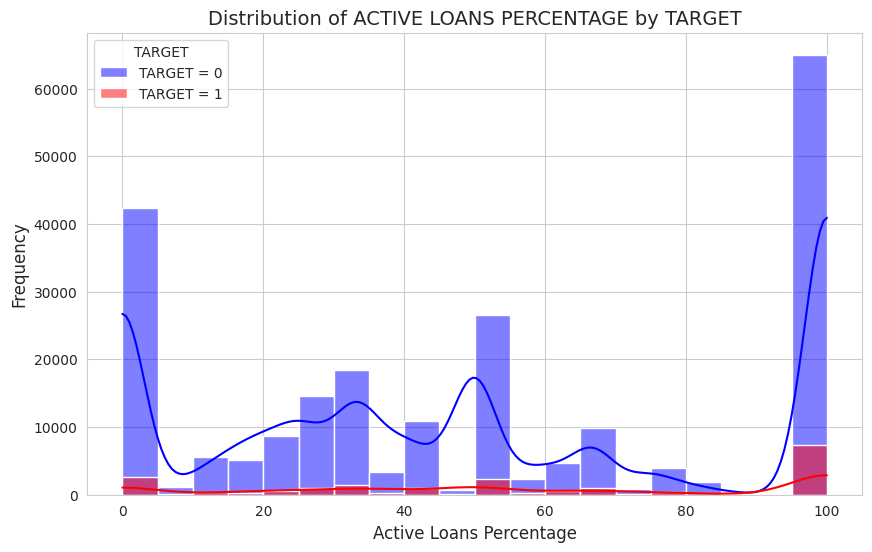

In [144]:
# Lọc dữ liệu cho TARGET = 0 và TARGET = 1
target_0 = atv_loans_target[atv_loans_target['TARGET'] == 0]['ACTIVE_LOANS_PERCENTAGE']
target_1 = atv_loans_target[atv_loans_target['TARGET'] == 1]['ACTIVE_LOANS_PERCENTAGE']

# Vẽ biểu đồ phân phối cho cả hai nhóm
plt.figure(figsize=(10, 6))
sns.histplot(target_0, color='blue', kde=True, label='TARGET = 0', bins=20)
sns.histplot(target_1, color='red', kde=True, label='TARGET = 1', bins=20)

# Thêm tiêu đề, nhãn và chú thích
plt.title('Distribution of ACTIVE LOANS PERCENTAGE by TARGET', fontsize=14)
plt.xlabel('Active Loans Percentage', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.legend(title='TARGET')

# Hiển thị biểu đồ
plt.show()

- The most striking insight is that the vast majority of clients, regardless of their TARGET status, have 100% active loans. This suggests that having all loans currently active is not a strong indicator of either high or low credit risk.

However, some subtle differences exist between the two groups:

- There's a small number of TARGET=0 clients with lower percentages of active loans, evidenced by the small bars around 0%, 20%, and 50%. These clients may have closed some of their loans.

- While both groups are heavily concentrated at 100%, the TARGET=1 group appears to have a slightly steeper distribution towards 100% compared to the TARGET=0 group.

<ipython-input-145-c5b830af25b2>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(atv_loans_target["ACTIVE_LOANS_PERCENTAGE"], bins=10,hist = False)


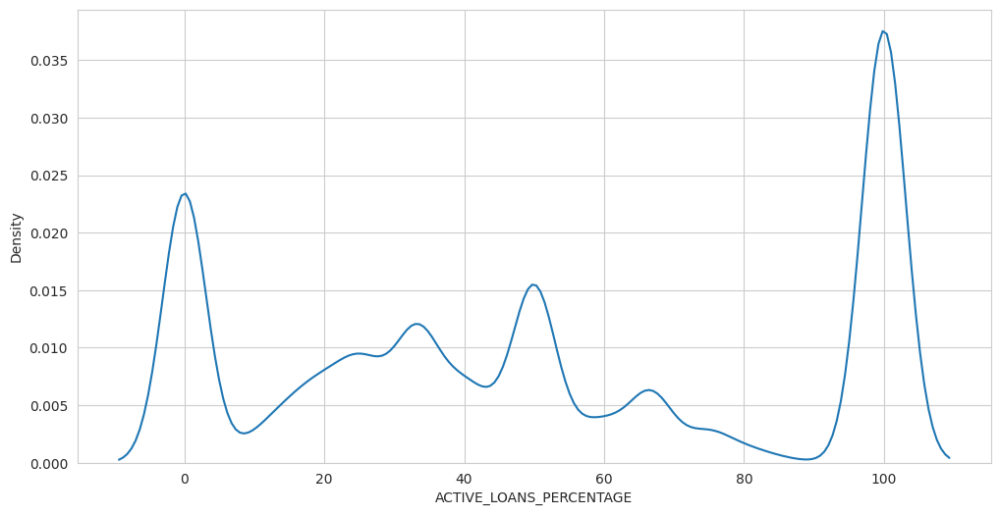

In [145]:
plt.figure(figsize= (12,6))
sns.distplot(atv_loans_target["ACTIVE_LOANS_PERCENTAGE"], bins=10,hist = False)
plt.show()

MERGE BUREAU_BALANCE VS BUREAU VS APPLICATION TRAIN

In [146]:
bb_merged = pd.merge(
    bureau_df,  # DataFrame chính (bureau)
    bureau_balance_df,  # DataFrame phụ (bureau_balance)
    how='left',  # Phép merge 'left' để giữ tất cả các dòng từ bureau_df
    on=['SK_ID_BUREAU']  # Merge trên cột SK_ID_BUREAU
)

# Hiển thị kết quả merge
bb_merged.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,MONTHS_BALANCE,STATUS
0,254629,5714462.0,Closed,currency 1,-497,0,-153.0,0,91323.0,0.00,91323.00,0.0,Consumer credit,-131,NaN,NaN
1,254629,5714463.0,Active,currency 1,-208,0,1075.0,0,225000.0,171342.00,53658.00,0.0,Credit card,-20,NaN,NaN
2,254629,5714467.0,Active,currency 1,-273,0,-298.0,0,180000.0,71017.38,108982.62,0.0,Credit card,-31,NaN,NaN
3,254629,5714468.0,Active,currency 1,-43,0,79.0,0,42103.8,42103.80,0.00,0.0,Consumer credit,-22,NaN,NaN
4,254629,5714458.0,Closed,currency 1,-1872,0,-776.0,0,494550.0,0.00,494550.00,0.0,Consumer credit,-696,NaN,NaN


# FEATURE ENGINEERING

In [154]:
def group(df_to_agg, prefix, aggregations, aggregate_by='SK_ID_CURR'):
    agg_df = df_to_agg.groupby(aggregate_by).agg(aggregations)
    agg_df.columns = pd.Index(['{}{}_{}'.format(prefix, e[0], e[1].upper())
                               for e in agg_df.columns.tolist()])
    return agg_df.reset_index()


def group_and_merge(df_to_agg, df_to_merge, prefix, aggregations, aggregate_by='SK_ID_CURR'):
    agg_df = group(df_to_agg, prefix, aggregations, aggregate_by=aggregate_by)
    return df_to_merge.merge(agg_df, how='left', on=aggregate_by)

In [155]:
def one_hot_encoder(df, categorical_columns=None, nan_as_category=True):
    """Create a new column for each categorical value in categorical columns using get dummies. """
    original_columns = list(df.columns)
    if not categorical_columns:
        categorical_columns = [
            col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns=categorical_columns,
                        dummy_na=nan_as_category)
    categorical_columns = [c for c in df.columns if c not in original_columns]
    return df, categorical_columns


def label_encoder(df, categorical_columns=None):
    """Encode categorical values as integers (0,1,2,3...) with pandas.factorize. """
    if not categorical_columns:
        categorical_columns = [
            col for col in df.columns if df[col].dtype == 'object']
    for col in categorical_columns:
        df[col], uniques = pd.factorize(df[col])
    return df, categorical_columns


def get_age_label(days_birth):
    """ Return the age group label (int).  - a type of label encoder"""
    age_years = -days_birth / 365
    if age_years < 27:
        return 1
    elif age_years < 40:
        return 2
    elif age_years < 50:
        return 3
    elif age_years < 65:
        return 4
    elif age_years < 99:
        return 5
    else:
        return 0


In [156]:
BUREAU_AGG = {
    'SK_ID_BUREAU': ['nunique'],
    'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
    'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
    'AMT_CREDIT_SUM_OVERDUE': ['max', 'mean', 'sum'],
    'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
    'BUREAU_IS_DPD': ['mean', 'sum'],
    'BUREAU_IS_DPD_OVER120': ['mean', 'sum'],
    'CNT_CREDIT_PROLONG': ['sum'],
    'CREDIT_ACTIVE_Active': ['mean'],
    'CREDIT_ACTIVE_Closed': ['mean'],
    'CREDIT_ACTIVE_Sold': ['mean'],
    'CREDIT_DAY_OVERDUE': ['max', 'mean', 'min'],
    'CREDIT_TYPE_Consumer credit': ['mean'],
    'CREDIT_TYPE_Credit card': ['mean'],
    'CREDIT_TYPE_Car loan': ['mean'],
    'CREDIT_TYPE_Mortgage': ['mean'],
    'CREDIT_TYPE_Microloan': ['mean'],
    'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
    'DAYS_CREDIT_UPDATE': ['mean'],
    'DEBT_CREDIT_DIFF': ['mean', 'sum'],
    'LL_AMT_CREDIT_SUM_OVERDUE': ['mean'],
    'LL_DEBT_CREDIT_DIFF': ['mean'],
    'LL_STATUS_12345': ['mean'],
    'MONTHS_BALANCE_MIN': ['min'],
    'MONTHS_BALANCE_MAX': ['max'],
    'MONTHS_BALANCE_MEAN': ['mean', 'var'],
    'MONTHS_BALANCE_SIZE': ['mean', 'sum'],
    'STATUS_0': ['mean'],
    'STATUS_1': ['mean'],
    'STATUS_12345': ['mean'],
    'STATUS_C': ['mean'],
    'STATUS_X': ['mean'],
}

BUREAU_ACTIVE_AGG = {
    'AMT_CREDIT_SUM': ['max', 'sum'],
    'AMT_CREDIT_SUM_DEBT': ['mean', 'sum'],
    'AMT_CREDIT_SUM_OVERDUE': ['max', 'mean'],
    'DAYS_CREDIT': ['max', 'mean'],
    'DAYS_CREDIT_ENDDATE': ['min', 'max'],
    'DAYS_CREDIT_UPDATE': ['min', 'mean'],
    'DEBT_PERCENTAGE': ['mean'],
    'DEBT_CREDIT_DIFF': ['mean'],
    'MONTHS_BALANCE_MEAN': ['mean', 'var'],
    'MONTHS_BALANCE_SIZE': ['mean', 'sum'],
}

BUREAU_CLOSED_AGG = {
    'AMT_CREDIT_SUM_OVERDUE': ['mean'],
    'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
    'AMT_CREDIT_SUM_DEBT': ['max', 'sum'],
    'DAYS_CREDIT': ['max', 'var'],
    'DAYS_CREDIT_ENDDATE': ['max'],
    'DAYS_CREDIT_UPDATE': ['max'],
    'DCREDIT_DOVERDUE_DIFF': ['mean'],
    'DUPDATE_DENDATE_DIFF': ['mean'],
    'STATUS_12345': ['mean'],
}

BUREAU_LOAN_TYPE_AGG = {
    'AMT_CREDIT_SUM': ['mean', 'max'],
    'AMT_CREDIT_SUM_DEBT': ['mean', 'max'],
    'DAYS_CREDIT': ['mean', 'max'],
    'DAYS_CREDIT_ENDDATE': ['max'],
    'DEBT_PERCENTAGE': ['mean'],
    'DEBT_CREDIT_DIFF': ['mean'],
    'DEBT_CREDIT_LIMIT_DIFF': ['mean'],
}

BUREAU_TIME_AGG = {
    'AMT_CREDIT_SUM_OVERDUE': ['mean'],
    'AMT_CREDIT_SUM': ['max', 'sum'],
    'AMT_CREDIT_SUM_DEBT': ['mean', 'sum'],
    'DEBT_PERCENTAGE': ['mean'],
    'DEBT_CREDIT_DIFF': ['mean'],
    'DEBT_CREDIT_LIMIT_DIFF': ['mean'],
    'STATUS_0': ['mean'],
    'STATUS_12345': ['mean'],
}




In [157]:
from scipy.stats import kurtosis, iqr, skew


def add_features_in_group(features, gr_, feature_name, aggs, prefix):
    '''
    Add new features to a dataframe groupby object.
        Input:
            features : dict
                Dictionary to store new features.
            gr_ : pandas.DataFrame
                Dataframe groupby object.
            feature_name : str
                Column name to calculate statistics.
            aggs : list
                List of method to calculate statistics.
            prefix : str
                Prefix of column names.
        Output:
            features : dict
                Dictionary with new features.
        '''
    for agg in aggs:
        if agg == 'sum':
            features[f'{prefix}{feature_name}_sum'] = gr_[
                feature_name].sum()
        elif agg == 'mean':
            features[f'{prefix}{feature_name}_mean'] = gr_[
                feature_name].mean()
        elif agg == 'max':
            features[f'{prefix}{feature_name}_max'] = gr_[
                feature_name].max()
        elif agg == 'min':
            features[f'{prefix}{feature_name}_min'] = gr_[
                feature_name].min()
        elif agg == 'std':
            features[f'{prefix}{feature_name}_std'] = gr_[
                feature_name].std()
        elif agg == 'count':
            features[f'{prefix}{feature_name}_count'] = gr_[
                feature_name].count()
        elif agg == 'skew':
            features[f'{prefix}{feature_name}_skew'] = skew(
                gr_[feature_name])
        elif agg == 'kurt':
            features[f'{prefix}{feature_name}_kurt'] = kurtosis(
                gr_[feature_name])
        elif agg == 'iqr':
            features[f'{prefix}{feature_name}_iqr'] = iqr(
                gr_[feature_name])
        elif agg == 'median':
            features[f'{prefix}{feature_name}_median'] = gr_[
                feature_name].median()
    return features


def add_ratios_features(df):
    '''
    Calculate several ratios for the main dataset.
        Input:
            df : pandas.DataFrame
                Dataframe after merge with all other dataframes.
        Output:
            df : pandas.DataFrame
                Final ataframe with ratios added.
    '''

    # CREDIT TO INCOME RATIO
    df['BUREAU_INCOME_CREDIT_RATIO'] = df['BUREAU_AMT_CREDIT_SUM_MEAN'] / \
        df['AMT_INCOME_TOTAL']
    df['BUREAU_ACTIVE_CREDIT_TO_INCOME_RATIO'] = df['BUREAU_ACTIVE_AMT_CREDIT_SUM_SUM'] / \
        df['AMT_INCOME_TOTAL']

    # PREVIOUS TO CURRENT CREDIT RATIO
    df['CURRENT_TO_APPROVED_CREDIT_MIN_RATIO'] = df['APPROVED_AMT_CREDIT_MIN'] / \
        df['AMT_CREDIT']
    df['CURRENT_TO_APPROVED_CREDIT_MAX_RATIO'] = df['APPROVED_AMT_CREDIT_MAX'] / \
        df['AMT_CREDIT']
    df['CURRENT_TO_APPROVED_CREDIT_MEAN_RATIO'] = df['APPROVED_AMT_CREDIT_MEAN'] / df['AMT_CREDIT']


    # PREVIOUS TO CURRENT CREDIT TO ANNUITY RATIO
    df['CTA_CREDIT_TO_ANNUITY_MAX_RATIO'] = df['APPROVED_CREDIT_TO_ANNUITY_RATIO_MAX'] / \
        df['CREDIT_TO_ANNUITY_RATIO']
    df['CTA_CREDIT_TO_ANNUITY_MEAN_RATIO'] = df['APPROVED_CREDIT_TO_ANNUITY_RATIO_MEAN'] / \
        df['CREDIT_TO_ANNUITY_RATIO']

    # DAYS DIFFERENCES AND RATIOS
    df['DAYS_DECISION_MEAN_TO_BIRTH'] = df['APPROVED_DAYS_DECISION_MEAN'] / \
        df['DAYS_BIRTH']
    df['DAYS_CREDIT_MEAN_TO_BIRTH'] = df['BUREAU_DAYS_CREDIT_MEAN'] / df['DAYS_BIRTH']
    df['DAYS_DECISION_MEAN_TO_EMPLOYED'] = df['APPROVED_DAYS_DECISION_MEAN'] / \
        df['DAYS_EMPLOYED']
    df['DAYS_CREDIT_MEAN_TO_EMPLOYED'] = df['BUREAU_DAYS_CREDIT_MEAN'] / \
        df['DAYS_EMPLOYED']
    return df


In [158]:
import os
import pandas as pd
def bureau_balance(path_to_data):
    ''' Process dseb63_bureau_balance.csv and return a pandas dataframe. '''
    bb = pd.read_csv(os.path.join(path_to_data, '/content/dseb63_bureau_balance.csv'))

    # Credit duration and credit/account end date difference
    bb, cat_cols = one_hot_encoder(bb, nan_as_category=False)

    # Calculate rate for each category with decay
    bb_processed = bb.groupby('SK_ID_BUREAU')[cat_cols].mean().reset_index()

    # Min, Max, Count and mean duration of payments (months)
    agg = {'MONTHS_BALANCE': ['min', 'max', 'mean', 'size']}
    bb_processed = group_and_merge(bb, bb_processed, '', agg, 'SK_ID_BUREAU')

    del bb
    gc.collect()
    return bb_processed


In [159]:
import pandas as pd
import gc  # Import garbage collector for memory management

def bureau(path_to_data):
    """
    Process bureau_clean.csv and return a pandas dataframe with aggregated features.
    """
    bureau = pd.read_csv(f'/content/bureau_clean.csv')

    # Calculate additional features
    bureau['CREDIT_DURATION'] = -bureau['DAYS_CREDIT'] + bureau['DAYS_CREDIT_ENDDATE']
    bureau['DCREDIT_DOVERDUE_DIFF'] = bureau['DAYS_CREDIT'] - bureau['CREDIT_DAY_OVERDUE']
    bureau['DUPDATE_DENDATE_DIFF'] = bureau['DAYS_CREDIT_UPDATE'] - bureau['DAYS_CREDIT_ENDDATE']
    bureau['DEBT_PERCENTAGE'] = bureau['AMT_CREDIT_SUM'] / bureau['AMT_CREDIT_SUM_DEBT']
    bureau['DEBT_CREDIT_DIFF'] = bureau['AMT_CREDIT_SUM'] - bureau['AMT_CREDIT_SUM_DEBT']
    bureau['DEBT_CREDIT_LIMIT_DIFF'] = bureau['AMT_CREDIT_SUM'] - bureau['AMT_CREDIT_SUM_LIMIT']
    bureau['BUREAU_IS_DPD'] = bureau['CREDIT_DAY_OVERDUE'].apply(lambda x: 1 if x > 0 else 0)
    bureau['BUREAU_IS_DPD_OVER120'] = bureau['CREDIT_DAY_OVERDUE'].apply(lambda x: 1 if x > 120 else 0)

    # One-hot encoding
    bureau, _ = one_hot_encoder(bureau, nan_as_category=False)

    # Merge with bureau balance
    bureau = bureau.merge(bureau_balance(path_to_data), how='left', on='SK_ID_BUREAU')

    # Flag months with late payments
    bureau['STATUS_12345'] = 0
    for i in range(1, 6):
        bureau['STATUS_12345'] += bureau[f'STATUS_{i}']

    # Aggregate by number of months in balance
    features = ['AMT_CREDIT_SUM_OVERDUE', 'AMT_CREDIT_SUM', 'AMT_CREDIT_SUM_DEBT',
                'DEBT_PERCENTAGE', 'DEBT_CREDIT_DIFF', 'STATUS_0', 'STATUS_12345']
    agg_length = bureau.groupby('MONTHS_BALANCE_SIZE')[features].mean().reset_index()
    agg_length.rename({feat: 'LL_' + feat for feat in features}, axis=1, inplace=True)
    bureau = bureau.merge(agg_length, how='left', on='MONTHS_BALANCE_SIZE')
    del agg_length

    # General loans aggregations
    bureau_agg = group(bureau, 'BUREAU_', BUREAU_AGG)

    # Active and closed loans aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    bureau_agg = group_and_merge(active, bureau_agg, 'BUREAU_ACTIVE_', BUREAU_ACTIVE_AGG)
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    bureau_agg = group_and_merge(closed, bureau_agg, 'BUREAU_CLOSED_', BUREAU_CLOSED_AGG)
    del active, closed

    # Aggregations for specific loan types
    for credit_type in ['Consumer credit', 'Credit card', 'Mortgage', 'Car loan', 'Microloan']:
        type_df = bureau[bureau[f'CREDIT_TYPE_{credit_type}'] == 1]
        prefix = 'BUREAU_' + credit_type.split(' ', maxsplit=1)[0].upper() + '_'
        bureau_agg = group_and_merge(type_df, bureau_agg, prefix, BUREAU_LOAN_TYPE_AGG)
        del type_df

    # Time-based aggregations
    for time_frame in [6, 12]:
        prefix = f"BUREAU_LAST{time_frame}M_"
        time_frame_df = bureau[bureau['DAYS_CREDIT'] >= -30 * time_frame]
        bureau_agg = group_and_merge(time_frame_df, bureau_agg, prefix, BUREAU_TIME_AGG)
        del time_frame_df

    # Debt over credit ratios
    bureau_agg['BUREAU_DEBT_OVER_CREDIT'] = (
        bureau_agg['BUREAU_AMT_CREDIT_SUM_DEBT_SUM'] / bureau_agg['BUREAU_AMT_CREDIT_SUM_SUM']
    )
    bureau_agg['BUREAU_ACTIVE_DEBT_OVER_CREDIT'] = (
        bureau_agg['BUREAU_ACTIVE_AMT_CREDIT_SUM_DEBT_SUM'] / bureau_agg['BUREAU_ACTIVE_AMT_CREDIT_SUM_SUM']
    )

    gc.collect()
    return bureau_agg

In [160]:
from google.colab import drive
drive.mount('/content/drive')
bureau_df_ft = bureau('/content/drive')
file_path = '/content/drive/MyDrive/bureau_merge.csv'
bureau_df_ft.to_csv(file_path, index=False)

Mounted at /content/drive
